# Computer Vision - P4

### **Carefully read the file `README.md` as well as the following instructions before start coding.**

## Delivery

Up to **1 point out of 10** will be penalized if the following requirements are not fulfilled:

- Implemented code should be commented.

- The questions introduced in the exercises must be answered.

- Add title to the figures to explain what is displayed.

- Comments and answers need to be in **English**.

- The deliverable must be a file named **P4_Student1_Student2.zip** that includes:
    - The notebook P4_Student1_Student2.ipynb completed with the solutions to the exercises and their corresponding comments.

**Deadline (Campus Virtual): November 22th, 23:00 h** 

==============================================================================================
## Descriptors extraction for object detection, based on template matching, ORB, and HOG
==============================================================================================

The main topics of Laboratory 4 are:

    4.1) SSD and Normalized Cross-correlation for template matching

    4.2) HOG image descriptor for object (person) detection

    4.3) Recognition by correspondance, based on feature extraction (ORB)

In order to complete this practicum, the following concepts need to be understood: template matching, feature localization (Harris, Censure), feature descriptor (HOG,ORB, Sift) methods.

It is highly recommendable to structure the code in functions in order to reuse code for different tests and images and make it shorter and more readable. Specially the visualization commands should be encapsulated in separate functions.

In [1]:
import numpy as np
from matplotlib import pyplot as plt
from skimage import io
from skimage import img_as_float
from skimage.color import rgba2rgb, rgb2gray
from skimage.transform import rescale

In [404]:
def plot_images_line(images, titles, size = (12,12)):
    """
    function that shows the images on the same canvas with their corresponding titles
        images: list of images we want to plot together
        titles: list of corresponding titles of the images
    """
    canvas, axs = plt.subplots(nrows=1, ncols=len(images), figsize= size)
    
    for index,image in enumerate(images):
        ax = axs[index]
        ax.imshow(image, cmap='gray')
        ax.axis('off')
        ax.set_title(titles[index])

In [361]:
def show_details(image):
    """
    auxiliar function that shows us the details of the image
        image: the image we want to see its details
    """
    print('Shape:',image.shape)
    print('Data type:',image.dtype)
    print('Max:',image.max())
    print('Min:', image.min())
    print('Size:',image.size)

In [362]:
def plot_images(images,titles,ncols):
    """
    Function that shows the images on the same canvas with their corresponding titles
        images: list of images we want to plot together
        titles: list of corresponding titles of the images
        ncols: number of columns
    """
    
    nrows = len(images)//ncols
    fig, axs = plt.subplots(nrows=nrows, ncols=ncols,figsize=(12,12))
    
    index = 0
    for i in range(nrows):
        for j in range(ncols):
            ax = axs[i,j]
            ax.imshow(images[index], cmap='gray')
            ax.axis('off')
            ax.set_title(titles[index])
            index += 1
    plt.show()

## 1 Template matching

**1.1** Given the image 'einstein.png' and the template image 'eye.png', detect the location of the template in the image comparing the use of:
- SSD distance (hint: norm() in numpy.linalg).
- normalized cross-correlation (hint: match_template() of skimage.feature).

Don't forget to normalize the images (having pixel values between [0,1]) before comparing them.

Shape: (762, 595, 4)
Data type: uint8
Max: 255
Min: 0
Size: 1813560
Shape: (46, 46, 4)
Data type: uint8
Max: 255
Min: 0
Size: 8464


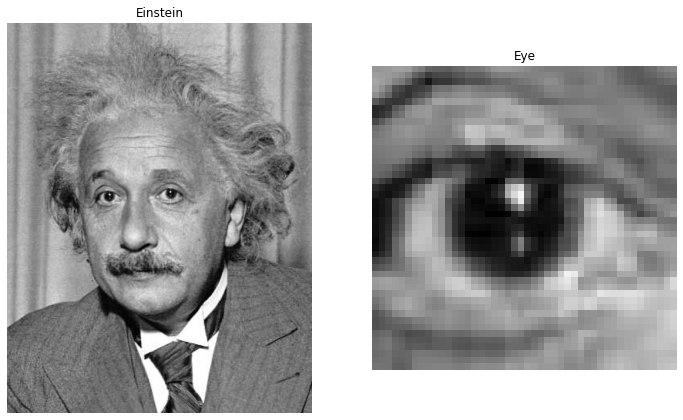

In [363]:
# First we read the images and plot them
einstein = io.imread('images/einstein.png')
eye = io.imread('images/eye.png')

show_details(einstein)
show_details(eye)

# We visualize them
images = [einstein, eye]
titles = ["Einstein", "Eye"]
plot_images_line(images, titles)

In [387]:
def ssd(image, template, threshold = -13):
    """
    function that detect template in the image with method ssd (sum of squared distance)
        image: original one
        template: the smaller patch to look in the original one
    """
    # First we normalise the image before comparing them
    image, template = img_as_float(image), img_as_float(template)
    
    # We look for the height and width we need to compare depending on the shape of both images
    height, width = image.shape[0] - template.shape[0], image.shape[1] - template.shape[1]

    # Now we apply the ssd formula creating a new zeros matrix
    new_image = np.zeros((height, width))
    
    # Using formula
    for i in range(height):
        for j in range(width):
            new_image[i,j] = np.sum((template - image[i:i+template.shape[0],j:j+template.shape[1]])**2)
            
    # Last we need to get 1-sqrt(SSD) image and the thresholded image (binarized)
    image_ssd_final = 1-np.sqrt(new_image)
    show_details(image_ssd_final)
    image_ssd_threshold = image_ssd_final > threshold
    
    # Plot them all in one line
    images = [image, image_ssd_final, image_ssd_threshold]
    titles = ["original image", "ssdistance", "thresholded ssd"]
    plot_images_line(images, titles)
    
    return images

In [388]:
from skimage.feature import match_template

def cross_correlation(image, template, threshold=0.6):
    """
    function that detect template in the image with method normalized cross correlation
        image: original one
        template: the smaller patch to look in the original one
    """
    # First we normalise the image before comparing them
    image, template = img_as_float(image), img_as_float(template)
    
    # Using algorithm formula
    image_cross = match_template(image, template)
    ij = np.unravel_index(np.argmax(image_cross), image_cross.shape) 
    x, y = ij[::-1]
    
    # Last we need to get the thresholded image (binarized)
    show_details(image_cross)
    image_cross_threshold = image_cross > threshold
    
    # Plot them all in one line
    images = [template, image_cross, image_cross_threshold]
    titles = ["template", "normalized cross-correlation", "thresholded normalized cross-correlation"]
    plot_images_line(images, titles)
    
    return images

In [366]:
# Now we apply the two template matching methods
# We choose the threshold values because of the maximum values of each image
#images = createImages(einstein, eye)

Create a function for template matching applying SSD distance and normalized cross-correlation and display the results in the following format:
    
<img src="images_notebook/tm.png" width="400" height="120">

**Use titles in all figures to understand what is being displayed.**

Shape: (716, 549)
Data type: float64
Max: -2.445967839131347
Min: -41.958906895554264
Size: 393084
Shape: (717, 550)
Data type: float64
Max: 0.9768202443115026
Min: -0.5212545112767212
Size: 394350
Shape: (716, 549)
Data type: float64
Max: -0.9895304595412764
Min: -23.802336460240326
Size: 393084


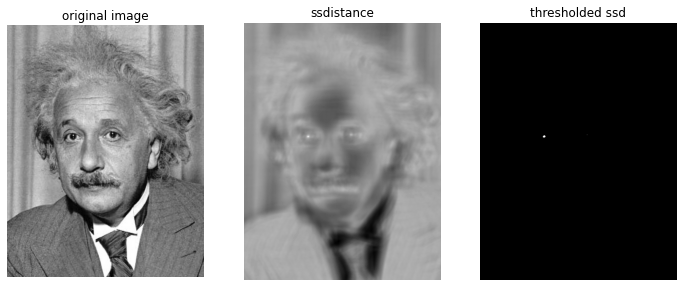

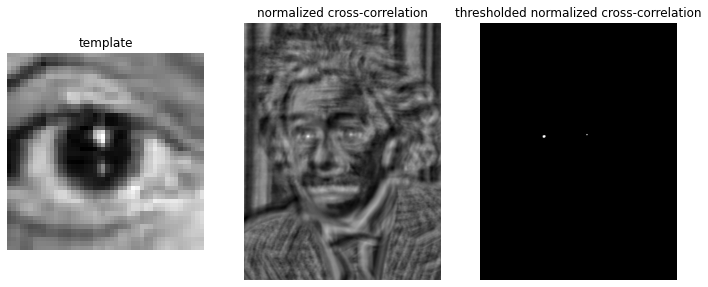

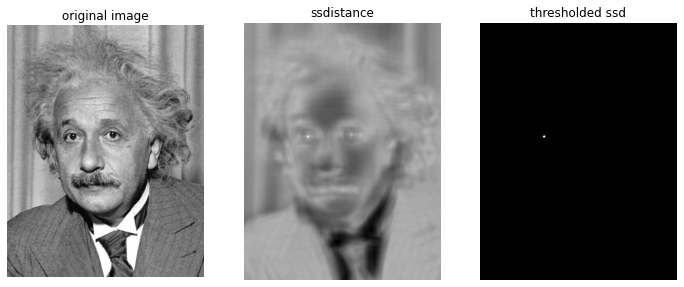

In [396]:
# Now we display the results
images_ssd = ssd(einstein, eye)
# We use 2 dimension for the cross correlation
einstein_gray = rgb2gray(rgba2rgb(einstein))
eye_gray = rgb2gray(rgba2rgb(eye))
images_cross = cross_correlation(einstein_gray, eye_gray, 0.55)
# Then, we need to know tha ssd method depends on the shape of the image, it not equal 2 dim, 3 dim or 4 dim, 
# we need to get a good threshold for each one
images_ssd_gray = ssd(einstein_gray, eye_gray, -7)

In [368]:
# Printing the min SSD and max NCC
print("Minimum SSD original:", images_ssd[1].min())
print("Maximum NCC original:", images_cross[1].max())

Minimum SSD original: -41.958906895554264
Maximum NCC original: 0.9768202443115026


**1.2** How does the result of the template matching change if the image changes its contrast (for example if you make it clearer or darker)? 

Similarly to the previous case, please, visualize the euclidean distance and normalized cross-correlation images as well as the binarized (thresholded) images in the two cases.

**Note:** Use titles of the figures to explain what is displayed.


> If we change the constrast of the original image, using template matching ssd we won't get the expected result, because it is sensitive. So it not robust to changes in brightness. That occurs because we don't have normalized the image, so when we check the local part to the patch is different in darker and the normal light.
So it will display the local part of the eye darker like the original one.

Read `einstein_br.png` and display the results on this image, using `eye.png` as template:

Shape: (762, 595)
Data type: uint16
Max: 65535
Min: 0
Size: 453390


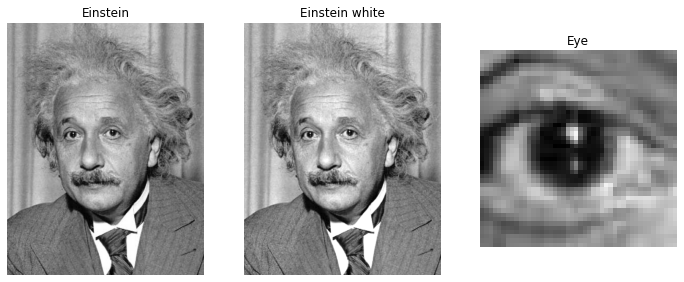

In [369]:
# First we plot the source images
einstein_br = io.imread('images/einstein_br.png')
eye = io.imread('images/eye.png')

show_details(einstein_br)

# We visualize the images
images = [einstein, einstein_br, eye]
titles = ["Einstein", "Einstein white", "Eye"]
plot_images_line(images, titles)

Shape: (716, 549)
Data type: float64
Max: -2.069853196384541
Min: -23.988930994057835
Size: 393084
Shape: (717, 550)
Data type: float64
Max: 0.9768232838639532
Min: -0.5212545689630339
Size: 394350


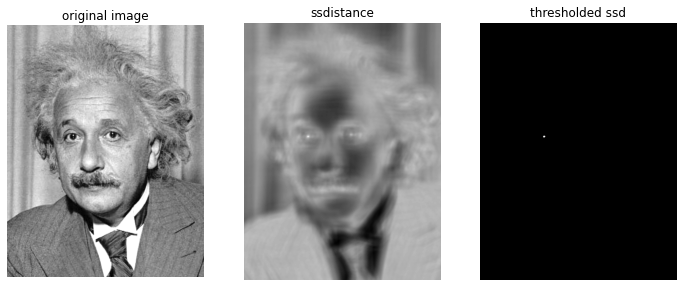

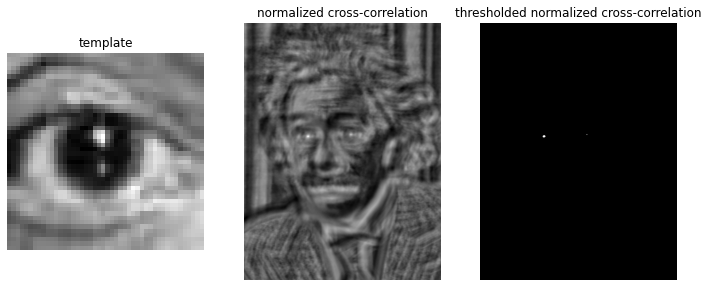

In [370]:
# Now we display the results, as the dimension os einstein_br is 2, eye need 2 too
images_ssd_br = ssd(einstein_br, eye_gray, -7)
images_cross_br = cross_correlation(einstein_br, eye_gray)

Print the minimum SSD and the maximum Normalized Cross-Correlation (NCC)

In [371]:
# Printing the min SSD and max NCC
print("Minimum SSD br:", images_ssd_br[1].min())
print("Maximum NCC br:", images_cross_br[1].max())

Minimum SSD br: -23.988930994057835
Maximum NCC br: 0.9768232838639532


**1.3** Read `einstein_mask.png` and display the results on this image, using the `eye.png` template:

Shape: (762, 595)
Data type: uint16
Max: 65535
Min: 0
Size: 453390


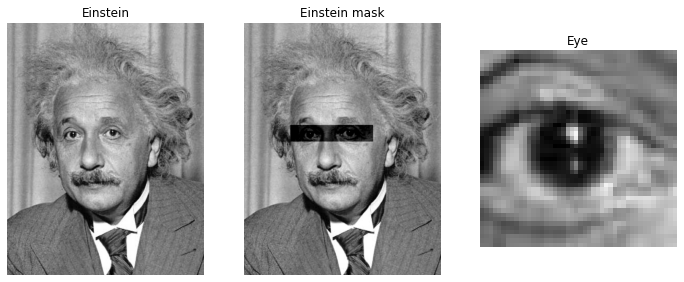

In [372]:
# Same as before
einstein_mask = io.imread('images/einstein_mask.png')
eye = io.imread('images/eye.png')

show_details(einstein_mask)

# We visualize the images
images = [einstein, einstein_mask, eye]
titles = ["Einstein", "Einstein mask", "Eye"]
plot_images_line(images, titles)

Shape: (716, 549)
Data type: float64
Max: -7.272637089446572
Min: -23.802336460240326
Size: 393084
Shape: (717, 550)
Data type: float64
Max: 0.6166362739337311
Min: -0.521254511276723
Size: 394350


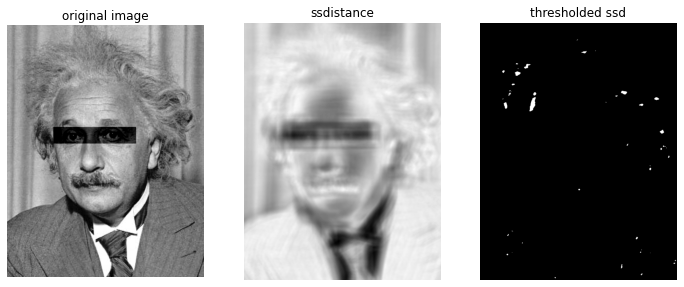

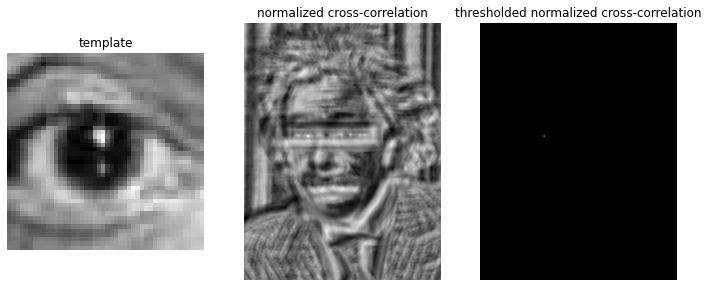

In [373]:
# Now we display the results, as the dimension os einstein_br is 2, eye need 2 too
images_ssd_mask = ssd(einstein_mask, eye_gray, -8) 
images_cross_mask = cross_correlation(einstein_mask, eye_gray, 0.55)

Print the minimum SSD and the maximum NCC

In [374]:
# Printing the min SSD and max NCC
print("Minimum SSD mask:", images_ssd_mask[1].min())
print("Maximum NCC mask:", images_cross_mask[1].max())

Minimum SSD mask: -23.802336460240326
Maximum NCC mask: 0.6166362739337311


What are the distances between the template and the image around the eyes of the image? 

> We can see perfectly in both images above, there is a difference of brightness around the eye od the original image and the template. So the distance is the constraste level or grade between both.

Comment the template matching process:
* Is the algorithms affected by contrast changes in the image?
* How do metrics (i.e. minimum euclidean distance and maximum NCC) change in all previous cases? Is there a big difference among these values?
* What parameters it has and which measure for image comparisons works better.

> Remember that the template matching is a method for searching and finding the location of a template image in a larger image. And in that exercise we work with the ssd method and the normalized cross correlation method. The first one is fast but sensitive and the second one is less sensitive to mask (dark or light) and image variance.

Is the algorithms affected by contrast changes in the image?
> Yes, exactly the ssd (sum of squared distances) method is strongly affected by the constrast in the eye part. We can see with the einstein_mask we already can not find the true detections of the eye template. Due to the change of value, and the ssd can not normalize them. So the result will have another values.

> But the cross correlation is not affected, as it is all normalized (including the original one and the template). So if we want to get the result, just need to take a decent value for threshold.

How do metrics (i.e. minimum SSD distance and maximum NCC) change in all previous cases? Is there a big difference among these values?
> First we can see a clear difference between the original min SSD and the other two (br and mask have similir values). That is caused by the constrast of the image in the second and the third comparing by the original one (all the values is "small" than the original one).

> Then, for the max NCC, the einstein mask image has the smallest NCC max value. The original and the bright one has a similar max NCC value, because the constrast applied do not affect a lot. And the difference between the third one comes for the normalization of the image. 

What parameters it has and which measure for image comparisons works better.
> Each template matching process needs a original images (which we need to find a local part in it), a template image (the patch we want to find in the original image) and a threshold value (helps to get the true detections in a binarized result).
> As we have seen in the three cases and possibles input of images, we conclude that is better the normalizad cross correlation, because it is constrast invariant!

**1.4** How does the result of the template matching change if instead the template is the one that changes its contrast (for example if you make it clearer or darker)? To this purpose, use the `eye_br.png` template.

Shape: (46, 46)
Data type: uint16
Max: 65535
Min: 0
Size: 2116


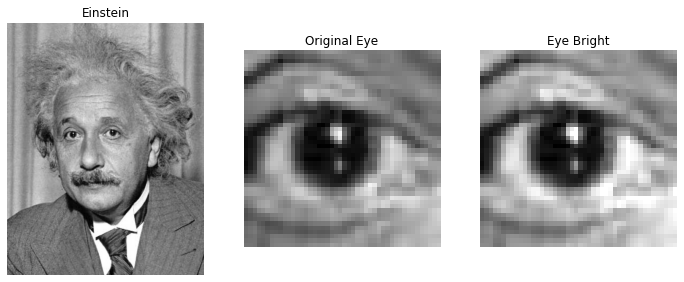

In [375]:
# We get the new template
eye_br = io.imread('images/eye_br.png')

show_details(eye_br)

# We visualize the images
images = [einstein, eye, eye_br]
titles = ["Einstein", "Original Eye", "Eye Bright"]
plot_images_line(images, titles)

Shape: (716, 549)
Data type: float64
Max: -4.270435388179585
Min: -23.620065098081664
Size: 393084
Shape: (717, 550)
Data type: float64
Max: 0.9765649754660753
Min: -0.5216486066526413
Size: 394350


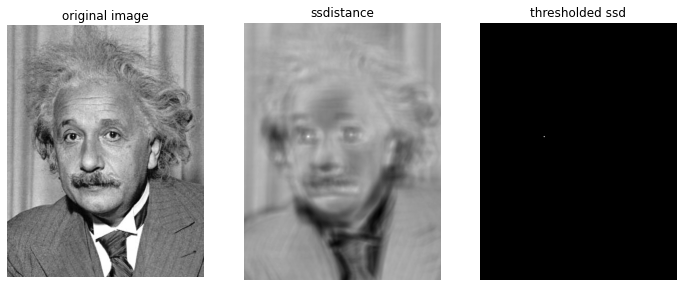

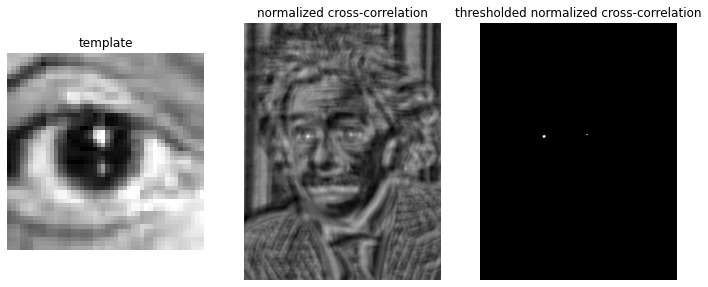

In [376]:
# Using the original image and the new template
images_ssd_eye_br = ssd(einstein_gray, eye_br, -6)
# We use 2 dimension for the cross correlation
images_cross_eye_br = cross_correlation(einstein_gray, eye_br, 0.55)

In [377]:
# Printing the min SSD and max NCC
print("Minimum SSD eye br:", images_ssd_eye_br[1].min())
print("Maximum NCC eye br:", images_cross_eye_br[1].max())

Minimum SSD eye br: -23.620065098081664
Maximum NCC eye br: 0.9765649754660753


How does the result of the template matching change if instead the template is the one that changes its contrast (for example if you make it clearer or darker)?
> Now we can compare between this one and the originals one. So we can say that there is almost no difference between the cross correlation algorithm in both cases but the range of SSD have changed. That is because the constrast of one of the images (original or template). That is, if we change the constrast in both images it will have no difference, but if we just change one it will have a clear difference.

Check how the result changes if the template is rotated.

Visualize the template and its rotation by 2º, 5º, 10º, 15º and 20º. Obtain again the template matching using the Euclidean distance and normalized cross-correlation.

**Help:** use the function rotate() in skimage.transform

Shape: (716, 549)
Data type: float64
Max: -0.9895304595412764
Min: -23.802336460240326
Size: 393084
Shape: (717, 550)
Data type: float64
Max: 0.9768202443115026
Min: -0.5212545112767212
Size: 394350
Shape: (716, 549)
Data type: float64
Max: -2.234920748868253
Min: -23.92509631606473
Size: 393084
Shape: (717, 550)
Data type: float64
Max: 0.9387339994970292
Min: -0.5039634371634003
Size: 394350
Shape: (716, 549)
Data type: float64
Max: -4.524531060224488
Min: -24.3217366785177
Size: 393084
Shape: (717, 550)
Data type: float64
Max: 0.8338366421524281
Min: -0.4524459215262987
Size: 394350
Shape: (716, 549)
Data type: float64
Max: -6.800848507934561
Min: -24.914233624890652
Size: 393084
Shape: (717, 550)
Data type: float64
Max: 0.6962212519640845
Min: -0.4008508265256603
Size: 394350
Shape: (716, 549)
Data type: float64
Max: -8.326538401039633
Min: -25.623573156731524
Size: 393084
Shape: (717, 550)
Data type: float64
Max: 0.5948608659487896
Min: -0.413694724891786
Size: 394350
Shape: (716, 

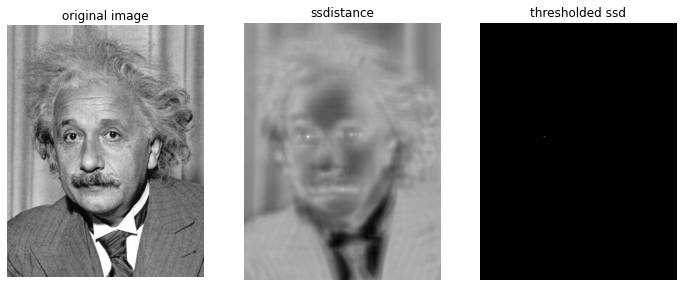

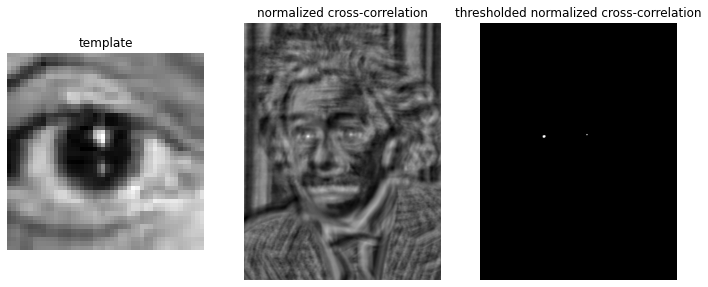

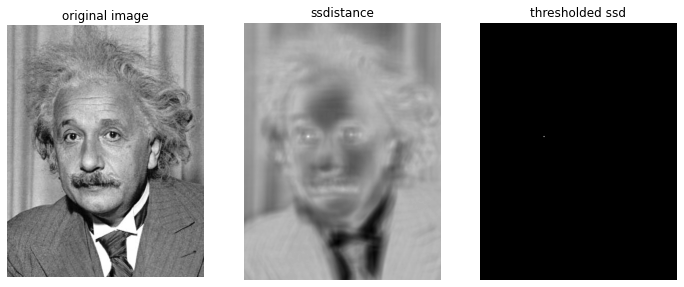

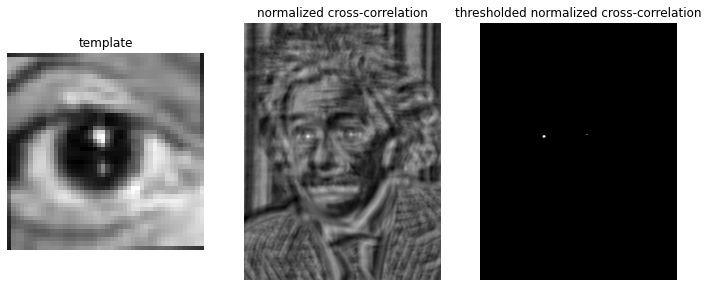

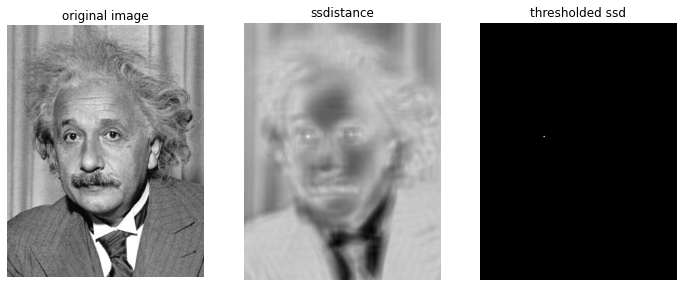

...

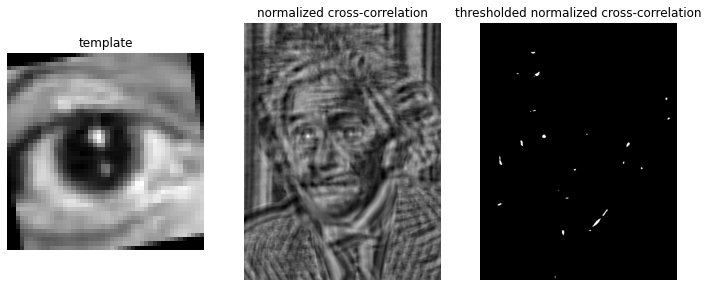

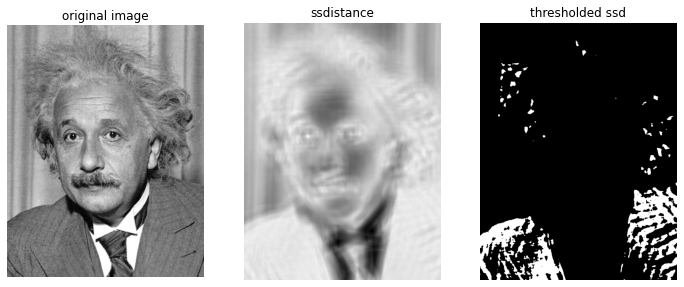

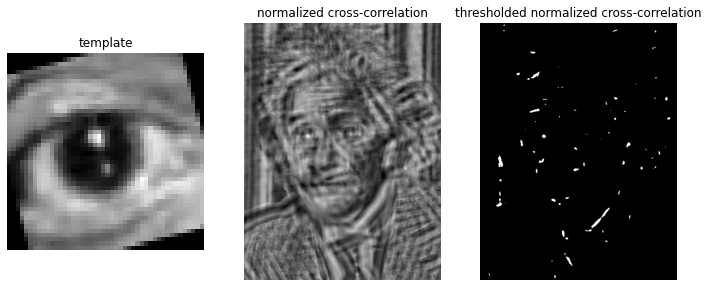

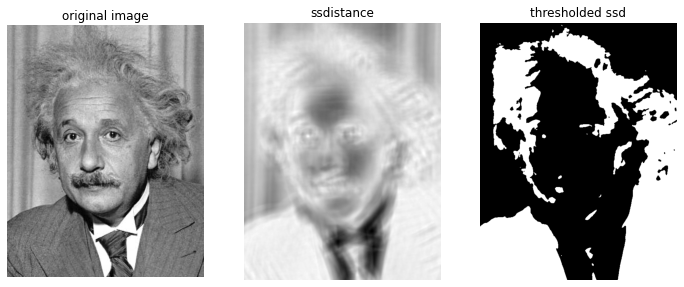

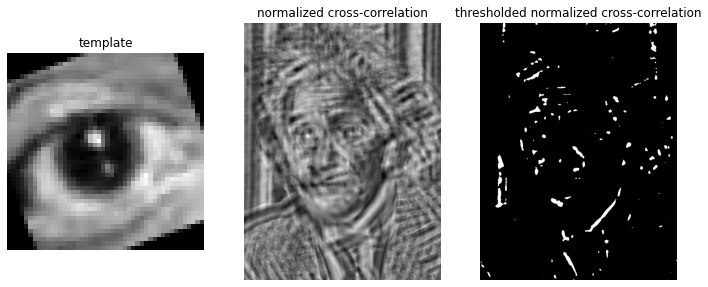

In [400]:
from skimage.transform import rotate

# Define the 5 rotations
eye_2 = rotate(eye_gray, 2)
eye_5 = rotate(eye_gray, 5)
eye_10 = rotate(eye_gray, 10)
eye_15 = rotate(eye_gray, 15)
eye_20 = rotate(eye_gray, 20)

# Use five times both algorithms
images_ssd = ssd(einstein_gray, eye_gray, -3)
images_cross = cross_correlation(einstein_gray, eye_gray, 0.55)
images_ssd_2 = ssd(einstein_gray, eye_2, -4)
images_cross_2 = cross_correlation(einstein_gray, eye_2, 0.55)
images_ssd_5 = ssd(einstein_gray, eye_5, -6)
images_cross_5 = cross_correlation(einstein_gray, eye_5, 0.4)
images_ssd_10 = ssd(einstein_gray, eye_10, -8)
images_cross_10 = cross_correlation(einstein_gray, eye_10, 0.35)
images_ssd_15 = ssd(einstein_gray, eye_15, -10)
images_cross_15 = cross_correlation(einstein_gray, eye_15, 0.3)
images_ssd_20 = ssd(einstein_gray, eye_20, -12)
images_cross_20 = cross_correlation(einstein_gray, eye_20, 0.25)

Check how the result changes if the template is rotated.
> We can see that is lost precision when the ratation grade is bigger, if the rotate is small like 2 or 5 we can look for the results (true detections) giving a threshold, but if the rotation grade is big like 15 or 20 there is no true detections, so both algorithms are not rotation invariant!

Comment the template matching process:
* Please, explain briefly the algorithm, including advantages and disadvantage
* Is the algorithms affected by contrast changes in the tempate image?
* What parameters it has and which measure for image comparisons works better.

Please, explain briefly the algorithm, including advantages and disadvantage.
> We have two algorithms. The first one is the Sum of Squared Distances, as his name says, is based on making the SSD between the template and a part of the original image (do that for each pixel). The result tells us that where is similar comparing with the template, the SSD will small, but as then we substract 1 by the value, so the final result have the true detections in the high values. It have advantages like the speed of the algorithm but disadvantages like the sensitibility to constrat (brightness change).
Then the second one, normalized cross correlation, this algorithms normalized all, the template and the image to comparing, so it best advantage is constrast invariant (on the contrary to ssd) but disadvantage for his speed computing.

# 2 Histogram of Oriented Gradients

In this section we will treat the following topic: HOG image descriptor. Application to person detection.

The Histogram of Oriented Gradients (HOG) feature descriptor is classical image descriptor for object detection.

Given the image `person_template.bmp` and the folder `/images/TestPersonImages/`, apply the HOG descriptor in order to detect where there is a person in the images. To this purpose, apply the "sliding window" technique. We use images from GRAZ 01 data from [INRIA datasets](http://pascal.inrialpes.fr/data/human/).

**2.1.** Read the template (`person_template.bmp`), obtain its HOG descriptor (with the optimal parameters) and visualize it.

Help: the HOG detector function is in the skimage.feature library ([Help](http://scikit-image.org/docs/dev/auto_examples/features_detection/plot_hog.html#sphx-glr-auto-examples-features-detection-plot-hog-py)).

In [1030]:
from skimage.feature import hog
from skimage import data, exposure
def HOGimage(image, r = 50):
    """
    function that returns the HOG descriptor by the follow parametres 
    """
    fd, image_hog = hog(image, orientations=9, pixels_per_cell=(5, 5), cells_per_block=(2, 2), visualize=True)
    hog_rescaled = exposure.rescale_intensity(image_hog, in_range=(0, r))
    
    return image_hog

Shape: (129, 49, 4)
Data type: uint8
Max: 255
Min: 0
Size: 25284


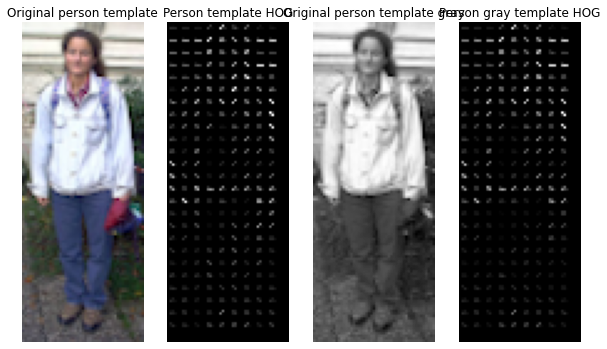

In [1031]:
from skimage.feature import hog
from skimage import data, exposure

# First we read the images
person_template = io.imread('images/person_template.bmp')
person_template_gray = rgb2gray(rgba2rgb(person_template))

show_details(person_template)

# Apply HOG
person_template_hog = HOGimage(person_template, 25)
perso_gray_template_hog = HOGimage(person_template_gray, 20)

# Visualize
plot_images_line([person_template, person_template_hog, person_template_gray, perso_gray_template_hog], 
                 ["Original person template", "Person template HOG", "Original person template gray", "Person gray template HOG"], (10,10))

**2.2.** Apply the HOG descriptor on the complete set of images for person detection.

a) Read images from the folder "TestPersonImages", slide a window on each image, obtain the HOG descriptor and compare to the HOG descriptor of the person template. 

b) Visualize the location in the image that is the most similar to the person template using the distance between the template and test image descriptors.

Display the results of every person detection following this format:

<img src="images_notebook/hog.png" width="800" height="100">

In [1032]:
# Reading a sequence of images from a folder
ic = io.ImageCollection('images/TestPersonImages/*.bmp')

In [1033]:
# That is a sliding_window implementation, for our function compareHOG we will modificate something
def sliding_window(image, stepSize, windowSize):
    """
    Rectangular region of fixed width and height that “slides” across an image.
        image: that we are going to loop over.
        stepSize: indicates how many pixels we are going to “skip” in both the (x, y) direction. 
                    Normally, we would not want to loop over each and every pixel of the image 
                    (i.e.  stepSize=1 ) as this would be computationally prohibitive if we were 
                    applying an image classifier at each window.
        windowSize: width and height (in terms of pixels) of the window we are going to extract from our image.
    """
    # slide a window across the image
    for y in range(0, image.shape[0], stepSize):
        for x in range(0, image.shape[1], stepSize):
            # yield the current window
            yield (x, y, image[y:y + windowSize[1], x:x + windowSize[0]])
            

In [1049]:
from heapq import heappop, heappush, heapify
import matplotlib.patches as patches
# Modification of the sliding_window method
# We can use a stepSize by 5
def compareHOG(image, template, stepSize = 5):
    # We get the size
    windowSize = (template.shape[0], template.shape[1])
    
    # We compute the hog image of the data set and the template
    hog_image = HOGimage(image, 60)
    hog_template = HOGimage(template, 20)
            
    # Create a max heap to save all window correlation for finally get the max one
    # Creating empty heap
    heap = []
    heapify(heap)

    #pq = PriorityQueue()
    #print(image.shape, template.shape)
    # sliding window
    for i in range(1, image.shape[0]-template.shape[0], stepSize):
        for j in range(1, image.shape[1]-template.shape[1], stepSize):
            # We compute the hog image of the window
            #fd, hog_image = hog(image[x:x + windowSize[0], y:y + windowSize[1]], orientations=9, pixels_per_cell=(8, 8), cells_per_block=(1, 1), visualize=True)
            #hog_rescaled = exposure.rescale_intensity(hog_image, in_range=(0, 10))
            hog_window = hog_image[i:i + windowSize[0], j:j + windowSize[1]]
            #print(hog_window.shape, hog_image.shape, hog_rescaled.shape, template.shape)
            # We compute the HOGs correlation
            # First we normalise the image before comparing them
            #hog_rescaled, template = img_as_float(hog_rescaled), img_as_float(template)
            hog_window, hog_template = img_as_float(hog_window), img_as_float(hog_template)
            # Using algorithm formula
            hog_correlation = match_template(hog_window, hog_template)
            ij = np.unravel_index(np.argmax(hog_correlation), hog_correlation.shape) 
            x, y = ij[::-1]
            #hog_correlation = cross_correlation(hog_rescaled, template)[1]
            
            #plt.imshow(hog_correlation)
            
            #hog_correlation = match_template(hog_rescaled, template)
            #ij = np.unravel_index(np.argmax(hog_correlation), hog_correlation.shape) 
            #x, y = ij[::-1]
            
            # Save the information in the set
            #pq.put([hog_correlation, (x,y)])
            heappush(heap, [-hog_correlation, (i,j)])
            #print([hog_correlation, (i,j)])
            
    # Get the maximum correlation hog
    better = heap[0]
    x,y = better[1]
    #print(x,y)
    #x, y = 0,30
                            
    # Plot them all in one line with the rectangle window
    canvas, axs = plt.subplots(nrows=1, ncols=4, figsize= (15,6))
    #rect = patches.Rectangle((y, x), template.shape[1], x+template.shape[0], linewidth=2, edgecolor='r', facecolor='none')
    
    ax = axs[0]
    # Display the image
    ax.imshow(template, cmap='gray')
    ax.set_title("Person Template")
    
    ax = axs[1]
    ax.imshow(image, cmap='gray')
    # Create a Rectangle patch
    rect = patches.Rectangle((y, x), template.shape[1], template.shape[0], linewidth=2, edgecolor='r', facecolor='none')
    ax.add_patch(rect) # Add the patch to the Axes
    ax.set_title("Best Region Match")
    
    ax = axs[2]
    ax.imshow(hog_template, cmap='gray')
    ax.set_title("HOG Template")
    
    ax = axs[3]
    ax.imshow(hog_image, cmap='gray')
    # Create a Rectangle patch
    rect = patches.Rectangle((y, x), template.shape[1], template.shape[0], linewidth=2, edgecolor='r', facecolor='none')
    ax.add_patch(rect) # Add the patch to the Axes
    ax.set_title("HOG Distances")
    
    plt.show()
    

Image 0


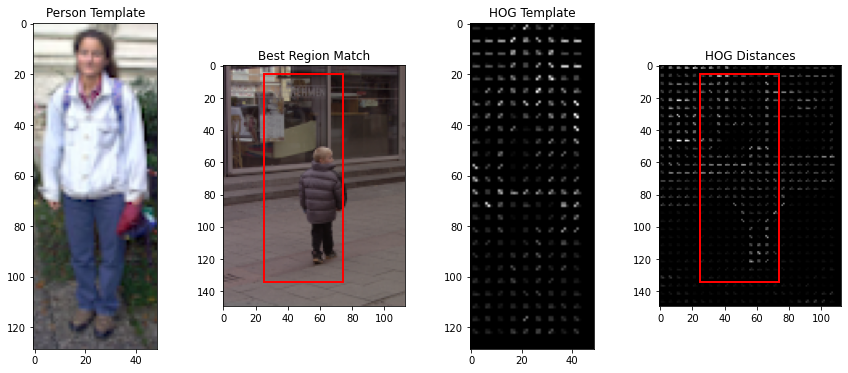

Image 1


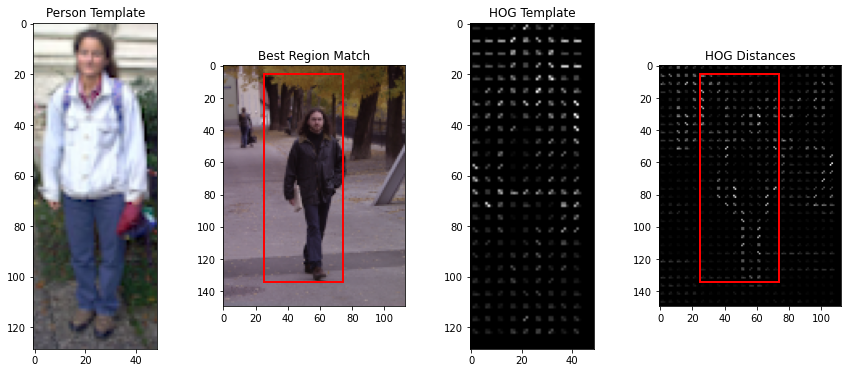

Image 2


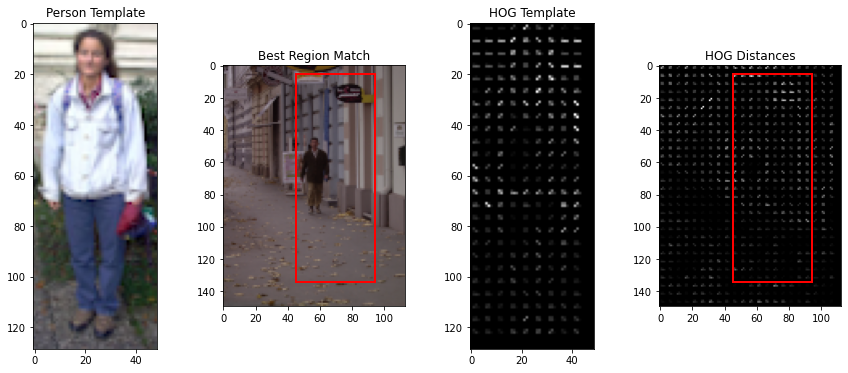

Image 3


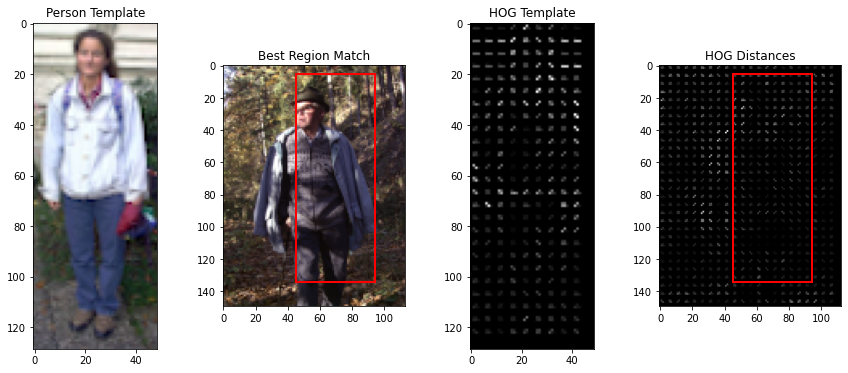

Image 4


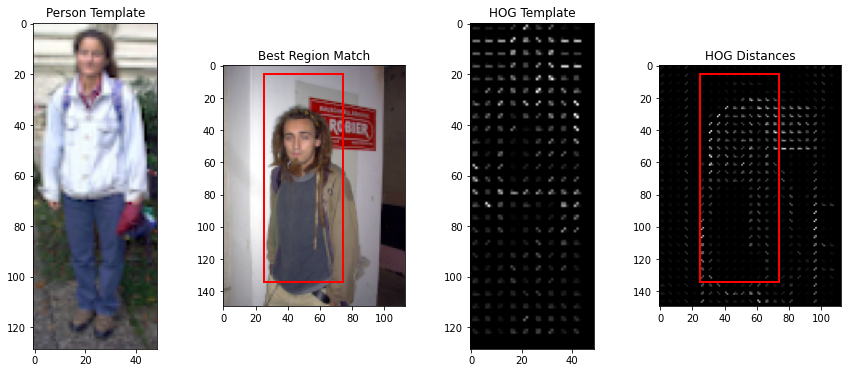

Image 5


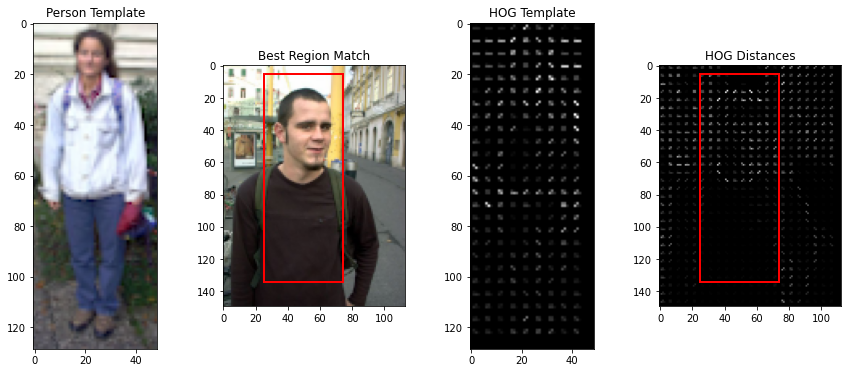

Image 6


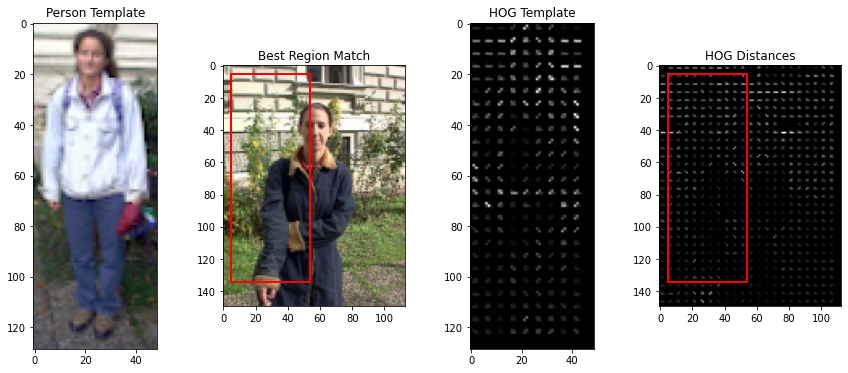

Image 7


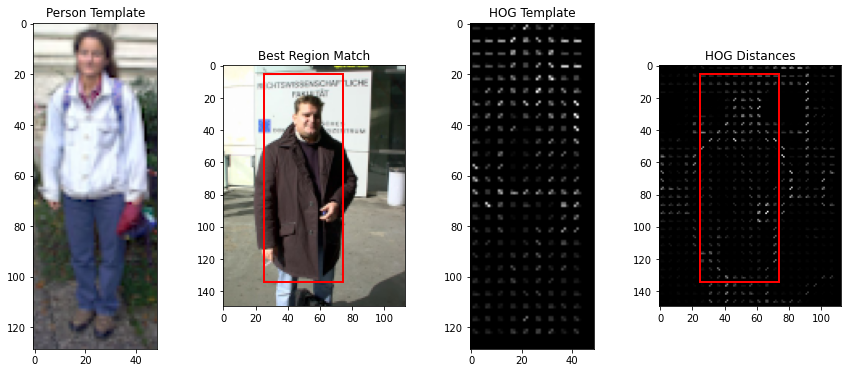

Image 8


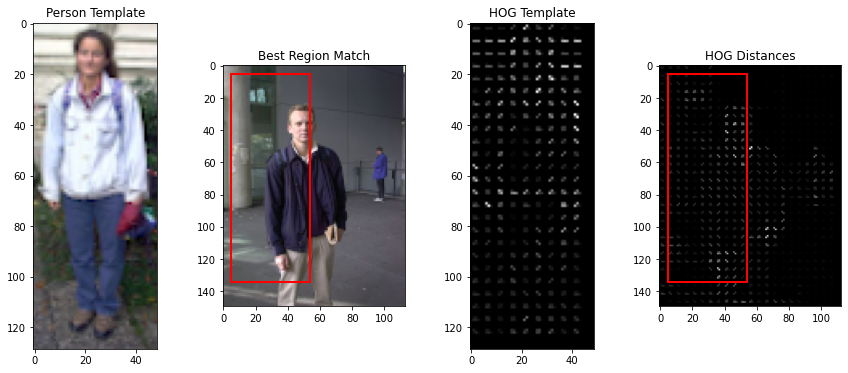

Image 9


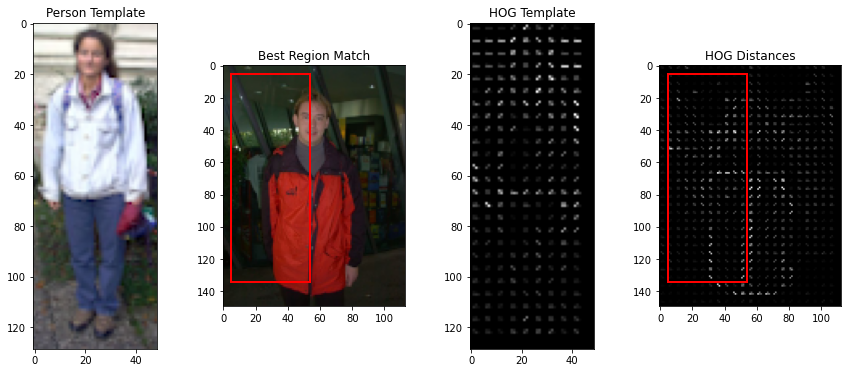

Image 10


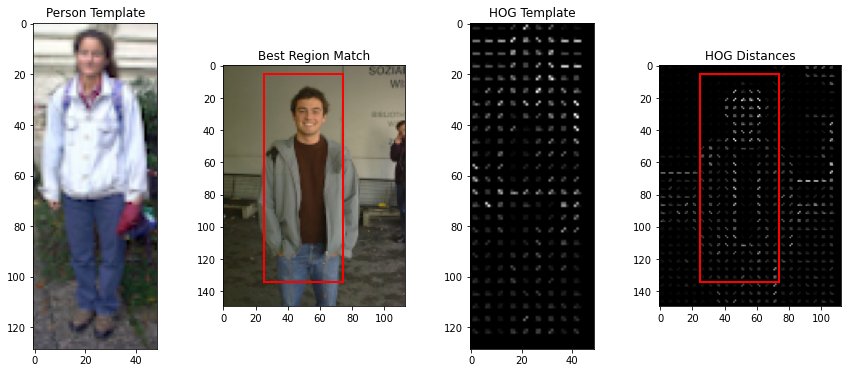

Image 11


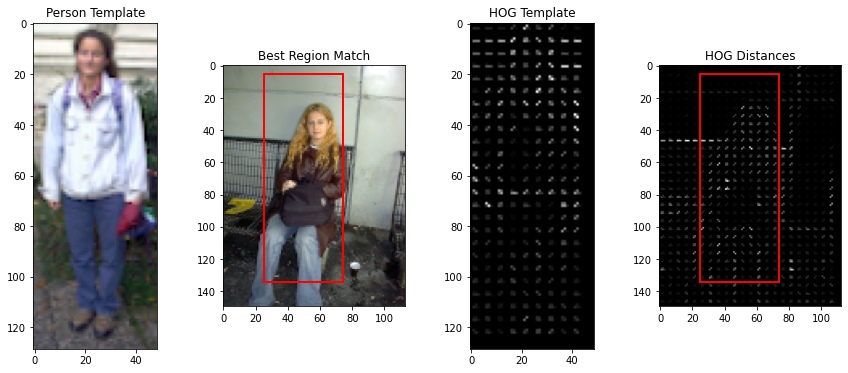

Image 12


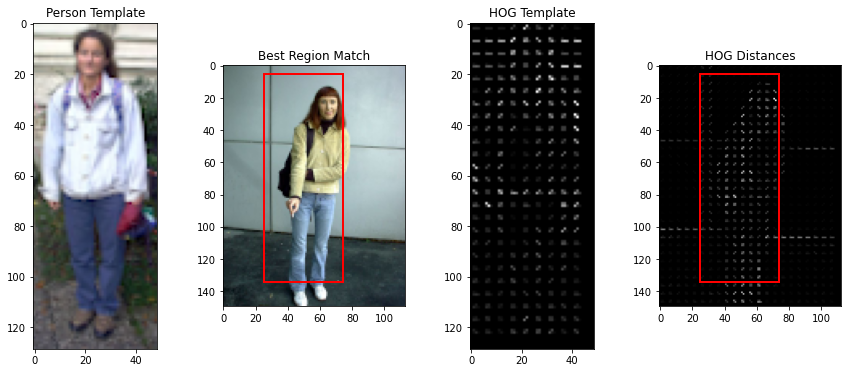

Image 13


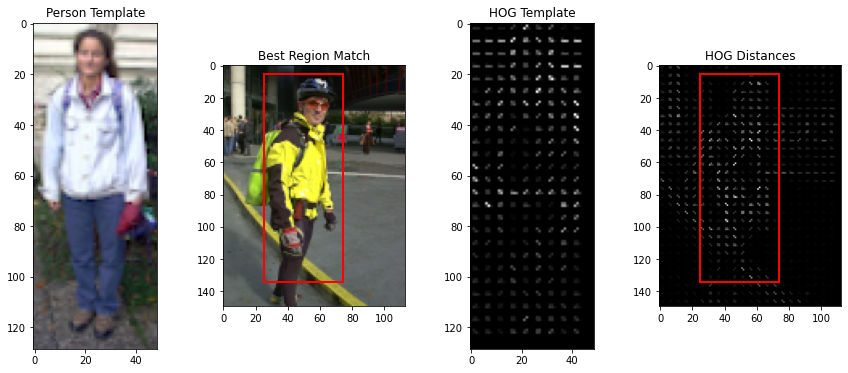

Image 14


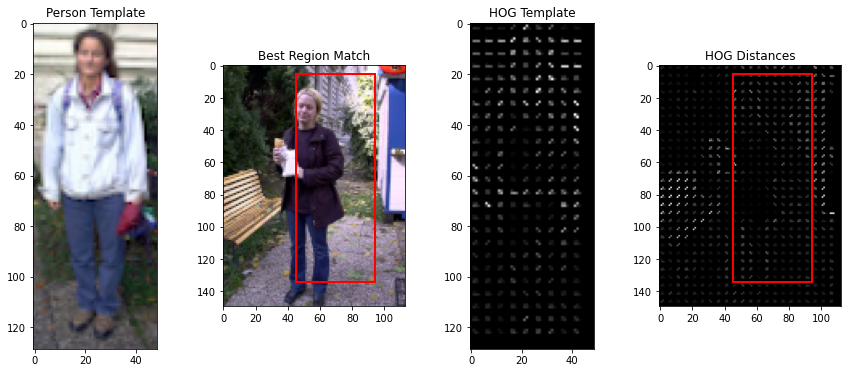

In [1050]:
# We use in grayscale for the template to have the same shape for do the correlation
#person_template_gray = rgb2gray(rgba2rgb(person_template))
#plt.imshow(ic[1])
#show_details(ic[1])
#compareHOG(ic[1], person_template_gray, 4)
"""Print en gris???"""
# We compare the HOG for all the data set trying to find a pedestrian
for i,j in enumerate(ic):
    print("Image", i)
    compareHOG(j, person_template, 4)

What is the dimension of your HOG descriptor? Explain it.

In [1059]:
fd1, image_hog1 = hog(person_template, orientations=9, pixels_per_cell=(5, 5), cells_per_block=(2, 2), visualize=True)
fd2, image_hog2 = hog(person_template, orientations=9, pixels_per_cell=(10, 10), cells_per_block=(2, 2), visualize=True)
fd3, image_hog3 = hog(person_template, orientations=9, pixels_per_cell=(5, 5), cells_per_block=(1, 1), visualize=True)
fd4, image_hog4 = hog(person_template, orientations=5, pixels_per_cell=(5, 5), cells_per_block=(1, 1), visualize=True)

print("Dimension of HOG Descriptor 1:", len(fd1), ", Shape image1:", image_hog1.shape)
print("Dimension of HOG Descriptor 2:", len(fd2), ", Shape image2:", image_hog2.shape)
print("Dimension of HOG Descriptor 3:", len(fd3), ", Shape image3:", image_hog3.shape)
print("Dimension of HOG Descriptor 4:", len(fd4), ", Shape image4:", image_hog4.shape)


Dimension of HOG Descriptor 1: 6912 , Shape image1: (129, 49)
Dimension of HOG Descriptor 2: 1188 , Shape image2: (129, 49)
Dimension of HOG Descriptor 3: 2025 , Shape image3: (129, 49)
Dimension of HOG Descriptor 4: 1125 , Shape image4: (129, 49)


> We have in the exemple different values of parameters. The dimension depends on the shape of the original image. Remenber that the image is formed by blocks, the blocks by cells and the cells by pixels. 

> In each case is: 1. Having the length 129, we get pixel per cell: 129//5 = 25 and 49//5 = 9 (so 25x9 cells). Then, cell per block 25-1=24 and 9-1=8 (so 24x8 blocks). Total is: 24x8x4x9 (24x8 blocks, 4 cells per block, 9 bins orientation).

> 2. Cells: 129//10=12 and 49//10=4. Blocks: 11x3. Cells per block: 2x2. Orientation: 9. Total feature vector: 12x3x4x9.

> 3. Cells: 129//5=25 and 49//5=9. Blocks: 25x9. Cells per block: 1x1. Orientation: 9. Total feature vector: 24x8x1x9.

> 4. Cells: 129//5=25 and 49//5=9. Blocks: 25x9. Cells per block: 1x1. Orientation: 5. Total feature vector: 24x8x1x5.

In [1073]:
print("Dimension of HOG Descriptor 1:", 24*8*4*9)
print("Dimension of HOG Descriptor 2:", 11*3*4*9)
print("Dimension of HOG Descriptor 3:", 25*9*9)
print("Dimension of HOG Descriptor 4:", 25*9*5)

Dimension of HOG Descriptor 1: 6912
Dimension of HOG Descriptor 2: 1188
Dimension of HOG Descriptor 3: 2025
Dimension of HOG Descriptor 4: 1125


Count on how many images were the persons detected correctly and discuss the failures.
What do you think can be the reasons for the failures?

> We can see the total of 15 images, we have 9 good detection, 3 failures and 3 regulary detections. In our experience, the most important reason of failure is there are some objects have a similar shape like the human or pedestrian contorn, in the background or hindering the main foreground.

Test several values of the parameters (``orientations``, ``pixels_per_cell``, ``cells_per_block``) to show which are the optimal values for the person detection problem.

> This parameters affect a lot to the final result of detection. Because it will generate diferent histograms and images of HOG, so in the comparison will have different values of correlation. 

> orientations: the number of orientation the histogram of gradient save. In total we have 360 grades of rotation, so 360 directions for the gradient. But if we divide by 9, we get 40 grades in one bin of thr gradient. So higher orientations can make and show all the details of a line directions. But not always we need that, things that have less movement or less forms, maybe better use a lower orientation value.

> pixel_per_cell: the number of pixel for one cell. Used for divide all pixels of the whole image in cells. Higher value of pixel per cell means more information in one histogram of gradient of that cell (so we can lose information if this values is big).

> cells_per_block: the number of cells (set of pixels) for one block. Used for divide all cells of the image in groups (blocks). Higher value of cells per block means more information of different cells, so the final feature vector can be different or small.

Comment the object detection process:
* Please, explain briefly the algorithm, including advantages and disadvantage
* Do you see any advantages of the HOG-based object detector compared to the template-based object detection? (The answer should be up to 10-15 lines).

Please, explain briefly the algorithm, including advantages and disadvantage.
> The "Template matching based on HOG for pedestrian detection" is a object detection algorithm. It works by comparing the feature vector of gradients of the template image and the others data set images to get the highest correlation "window" (it means the most similar local image that looks more alike) . 

> It depends a lot (is sensitive) to the other objects in the image sometimes, as you can see in the exemples, the images that have a clear background or less objects around, they are easier to detect the pedestrian. But no in the case with confusion with other color or shapes that can make the correlation high. So that is the disadvantage of this algorithm. 

> And for the advantages, comparing to the first topic of template matching, it is brightness invariant, not depends on the contrast of the images.

Do you see any advantages of the HOG-based object detector compared to the template-based object detection? (The answer should be up to 10-15 lines).
> As we answered in the previous questions, the best approch of this new algorithm, HOG based detection, is that the detection result is contrast invariant (or brightness invariant). It is not same like the template matching that have some methods which are so sentitive by the bright change and image change. 

> As we have said too, the template matching is rotation variant, it is not valid for detect the patch a template rotated. But in the HOG descriptor detection, it can make possible that detection if we add some fix or arrangment. As it is based on the direction of the constrast in each pixel, we can found a rotate patch or template in a data source image by fixing that rotation. That can be done turning thr direction of all gradients of the template image with the same degree to keep the same direction as the source image.

# 3 ORB feature detector and binary descriptor

Let us consider the problem of feature extraction that contains two subproblems: 
- feature location, 
- image feature description.

Let us focus on ORB, an approximation of SIFT method, and analyse if ORB is  scale and rotation invariant, a property that is very important for real-time applications.

**Hint:** `ORB` is a function within the module `skimage.feature`
                             
**Help**: We suggest to have a look at the [ORB example](http://scikit-image.org/docs/dev/auto_examples/features_detection/plot_orb.html) how to compute the ORB descriptors and find the descriptors match. You can use the function match_descriptors from `skimage.feature` module in order to compute and show the similar detected descriptors of the given images. 

**3.1** Detect the censure in the image `starbucks4.jpg`. Analyze and discuss the effect of different values of the parameters in censure function.

Shape: (194, 259, 3)
Data type: uint8
Max: 255
Min: 0
Size: 150738


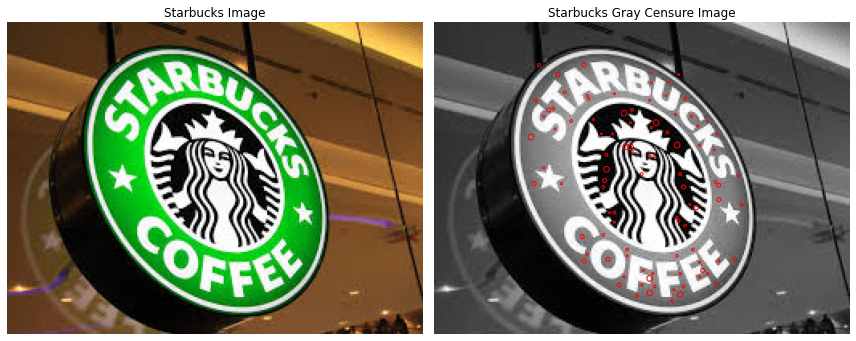

In [1101]:
from skimage.feature import CENSURE

# First we read the images 
starbucks4 = io.imread('images/starbucks4.jpg')
starbucks4_gray = rgb2gray(starbucks4)

show_details(starbucks4)

# Find the censure of the grayscale image and plot it
detector = CENSURE(min_scale=1, max_scale=7, mode='DoB', non_max_threshold=0.15, line_threshold=10)

fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(12, 6))

ax[0].imshow(starbucks4)
ax[0].set_title("Starbucks Image")

detector.detect(starbucks4_gray)

ax[1].imshow(starbucks4_gray, cmap=plt.cm.gray)
ax[1].scatter(detector.keypoints[:, 1], detector.keypoints[:, 0], 2**detector.scales, facecolors='none', edgecolors='r')
ax[1].set_title('Starbucks Gray Censure Image')

for a in ax:
    a.axis('off')

plt.tight_layout()
plt.show()

> WE have the following parameters of the CENSURE() function: min_scale is the minimum scale to extract keypoints from, if it is bigger we can get all the small censure (small circles). The max_scale is the maximum scale to extract keypoints from, it gives a 'limit' to the size of the censure. The keypoints will be extracted from all the scales except the first and the last i.e. from the scales in the range [min_scale + 1, max_scale - 1]. The filter sizes for different scales is such that the two adjacent scales comprise of an octave.

> The mode={'DoB', ‘Octagon’, ‘STAR’}, it is the type of bi-level filter used to get the scales of the input image. 
The parameter non_max_thresholdfloat, it ia a threshold value used to suppress maximas and minimas with a weak magnitude response obtained after Non-Maximal Suppression. This value can remove some size censure if it it bigger.
And the line_thresholdfloat, is a threshold for rejecting interest points which have ratio of principal curvatures greater than this value.

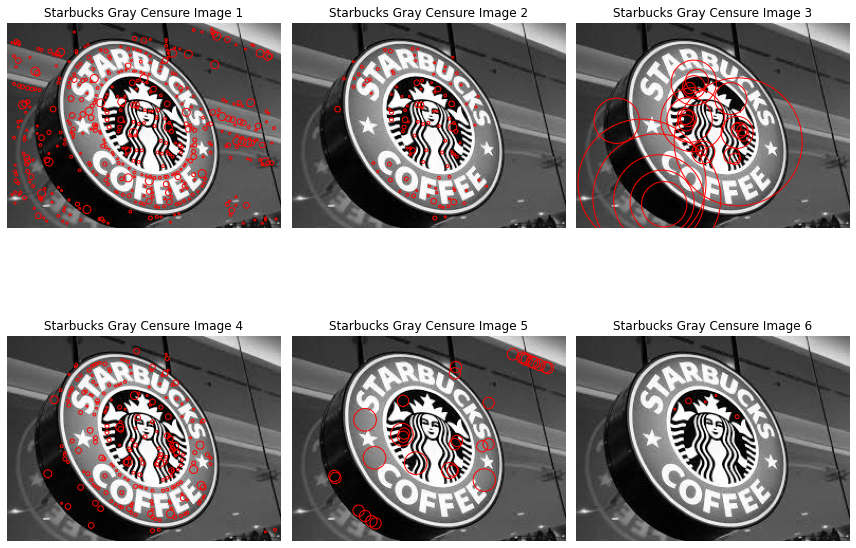

In [1106]:
# We can see some examples applying different parameters values
fig, ax = plt.subplots(nrows=2, ncols=3, figsize=(12, 10))

detector = CENSURE(min_scale=1, max_scale=7, mode='DoB', non_max_threshold=0.01, line_threshold=100)
detector.detect(starbucks4_gray)

ax[0][0].imshow(starbucks4_gray, cmap=plt.cm.gray)
ax[0][0].scatter(detector.keypoints[:, 1], detector.keypoints[:, 0], 2**detector.scales, facecolors='none', edgecolors='r')
ax[0][0].set_title('Starbucks Gray Censure Image 1')

detector = CENSURE(min_scale=1, max_scale=7, mode='DoB', non_max_threshold=0.2, line_threshold=50)
detector.detect(starbucks4_gray)

ax[0][1].imshow(starbucks4_gray, cmap=plt.cm.gray)
ax[0][1].scatter(detector.keypoints[:, 1], detector.keypoints[:, 0], 2**detector.scales, facecolors='none', edgecolors='r')
ax[0][1].set_title('Starbucks Gray Censure Image 2')

detector = CENSURE(min_scale=5, max_scale=15, mode='DoB', non_max_threshold=0.2, line_threshold=50)
detector.detect(starbucks4_gray)

ax[0][2].imshow(starbucks4_gray, cmap=plt.cm.gray)
ax[0][2].scatter(detector.keypoints[:, 1], detector.keypoints[:, 0], 2**detector.scales, facecolors='none', edgecolors='r')
ax[0][2].set_title('Starbucks Gray Censure Image 3')

detector = CENSURE(min_scale=1, max_scale=7, mode='Octagon', non_max_threshold=0.1, line_threshold=100)
detector.detect(starbucks4_gray)

ax[1][0].imshow(starbucks4_gray, cmap=plt.cm.gray)
ax[1][0].scatter(detector.keypoints[:, 1], detector.keypoints[:, 0], 2**detector.scales, facecolors='none', edgecolors='r')
ax[1][0].set_title('Starbucks Gray Censure Image 4')

detector = CENSURE(min_scale=6, max_scale=10, mode='Octagon', non_max_threshold=0.1, line_threshold=50)
detector.detect(starbucks4_gray)

ax[1][1].imshow(starbucks4_gray, cmap=plt.cm.gray)
ax[1][1].scatter(detector.keypoints[:, 1], detector.keypoints[:, 0], 2**detector.scales, facecolors='none', edgecolors='r')
ax[1][1].set_title('Starbucks Gray Censure Image 5')

detector = CENSURE(min_scale=1, max_scale=10, mode='STAR', non_max_threshold=0.5, line_threshold=200)
detector.detect(starbucks4_gray)

ax[1][2].imshow(starbucks4_gray, cmap=plt.cm.gray)
ax[1][2].scatter(detector.keypoints[:, 1], detector.keypoints[:, 0], 2**detector.scales, facecolors='none', edgecolors='r')
ax[1][2].set_title('Starbucks Gray Censure Image 6')


for a in ax[0]:
    a.axis('off')
    
for a in ax[1]:
    a.axis('off')

plt.tight_layout()
plt.show()

**3.2** Detect the correspondences between the model image `starbucks.jpg` with the scene image `starbucks4.jpg`. You can adapt the code from the [ORB example](http://scikit-image.org/docs/dev/auto_examples/features_detection/plot_orb.html) above. 

Define a function get_ORB implementing the algorithm in order to be able to apply it on different images. Comment the code in detail.

**Hint: If the function plot_matches() gives you an error you can use the plot_matches_aux() at the end of this file.**

Analyze and discuss the effect of different values of the parameter `max_ratio` in the match_descriptors function.


In [1200]:
def get_ORB(img1, img2, n_keyP=200, ratio = 1.0, figsize = (20,10)):
    """
    function that returns a result image by matching the keypoints of two images
        img1: one of the image we want to match with the other
        img2: the other image to be matched
        n_keyP: parameter of the ORB function
        ratio: parameter max_ratio for match_descritors() function
    """
    # First we convert to grayscale if necesary:
    if img1.shape[2] == 3:
        img1 = rgb2gray(img1)
    elif img1.shape[2] == 4:
        img1 = rgb2gray(rgba2rgb(img1))
    if img2.shape[2] == 3:
        img2 = rgb2gray(img2)
    elif img2.shape[2] == 4:
        img2 = rgb2gray(rgba2rgb(img2))
    
    # Oriented FAST and rotated BRIEF feature detector and binary descriptor extractor
    descriptor_extractor = ORB(n_keypoints=n_keyP)

    # Detect oriented FAST keypoints and extract BRIEF descriptors.
    descriptor_extractor.detect_and_extract(img1)
    # Getting the keypoints and descriptors of the first image 
    keypoints1 = descriptor_extractor.keypoints
    descriptors1 = descriptor_extractor.descriptors

    # Detect oriented FAST keypoints and extract BRIEF descriptors of the second image
    descriptor_extractor.detect_and_extract(img2)
    # Getting the keypoints and descriptors of the second image
    keypoints2 = descriptor_extractor.keypoints
    descriptors2 = descriptor_extractor.descriptors

    # For each descriptor in the first set this matcher finds the closest descriptor 
    # in the second set (and vice-versa in the case of enabled cross-checking).
    matches = match_descriptors(descriptors1, descriptors2, cross_check=True, max_ratio=ratio)
    
    fig, ax = plt.subplots(nrows=1, ncols=1, figsize = figsize)
    plot_matches(ax, img1, img2, keypoints1, keypoints2, matches)
    ax.axis('off')
    ax.set_title("Original Image vs. Transformed Image")
    plt.show()

> The parameters of the ORB function are: 

> downscale: Default value 1.2 is chosen so that there are more dense scales which enable robust scale invariance for a subsequent feature description. 

> n_scales: Maximum number of scales from the bottom of the image pyramid to extract the features from.

> n_keypoints: Number of keypoints to be returned. The function will return the best n_keypoints according to the Harris corner response if more than n_keypoints are detected. If not, then all the detected keypoints are returned.

> fast_n: Minimum number of consecutive pixels out of 16 pixels on the circle that should all be either brighter or darker w.r.t test-pixel. A point c on the circle is darker w.r.t test pixel p if Ic < Ip - threshold and brighter if Ic > Ip + threshold. Also stands for the n in FAST-n corner detector.

> fast_threshold: Threshold used to decide whether the pixels on the circle are brighter, darker or similar w.r.t. the test pixel. Decrease the threshold when more corners are desired and vice-versa.

> harris_k: Sensitivity factor to separate corners from edges, typically in range [0, 0.2]. Small values of k result in detection of sharp corners.

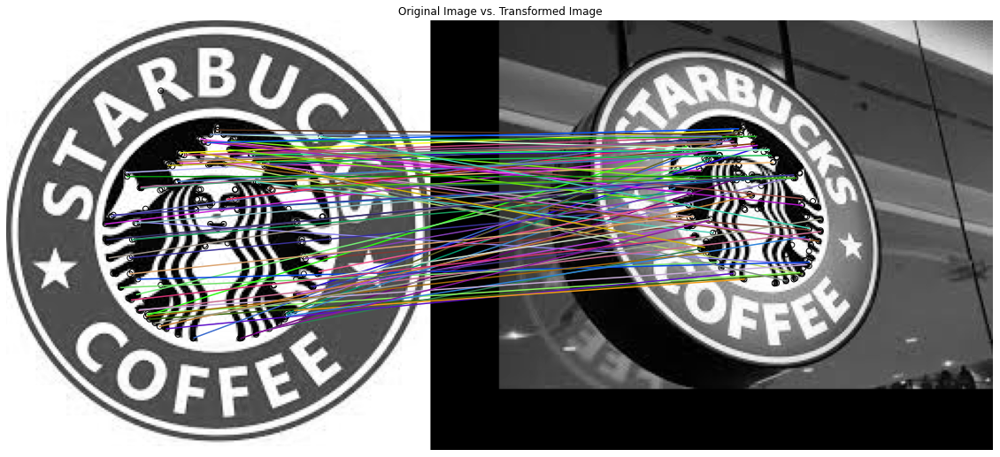

In [1201]:
# Read the images
starbucks = io.imread('images/starbucks.jpg')
starbucks4 = io.imread('images/starbucks4.jpg')

# Using the function get_ORB to match the logo in different perspectives
get_ORB(starbucks, starbucks4)

Analyze and discuss the effect of different values of the parameter max_ratio in the match_descriptors function.
> The parameters for the match_descritors() funtion are: 

> descriptors1: Descriptors of size P about M keypoints in the first image.

> descriptors2: Descriptors of size P about N keypoints in the second image.

> metric: {‘euclidean’, ‘cityblock’, ‘minkowski’, ‘hamming’, …}. The metric to compute the distance between two descriptors.  The hamming distance should be used for binary descriptors. By default the L2-norm is used for all descriptors of dtype float or double and the Hamming distance is used for binary descriptors automatically.

> p: The p-norm to apply for metric='minkowski'. By default is 2.

> max_distance: Maximum allowed distance between descriptors of two keypoints in separate images to be regarded as a match.

> cross_check: If True, the matched keypoints are returned after cross checking i.e. a matched pair (keypoint1, keypoint2) is returned if keypoint2 is the best match for keypoint1 in second image and keypoint1 is the best match for keypoint2 in first image. 

> max_ratio: By default is 1.0. Maximum ratio of distances between first and second closest descriptor in the second set of descriptors. This threshold is useful to filter ambiguous matches between the two descriptor sets. The choice of this value depends on the statistics of the chosen descriptor, e.g., for SIFT descriptors a value of 0.8 is usually chosen.

> So the max_ratio is usefull to get correct candidate matches between a local point feature in two images. It will be closer if is smaller, but more difficult to get matched when small because need to be equal and that is not real. Going to see some examples:

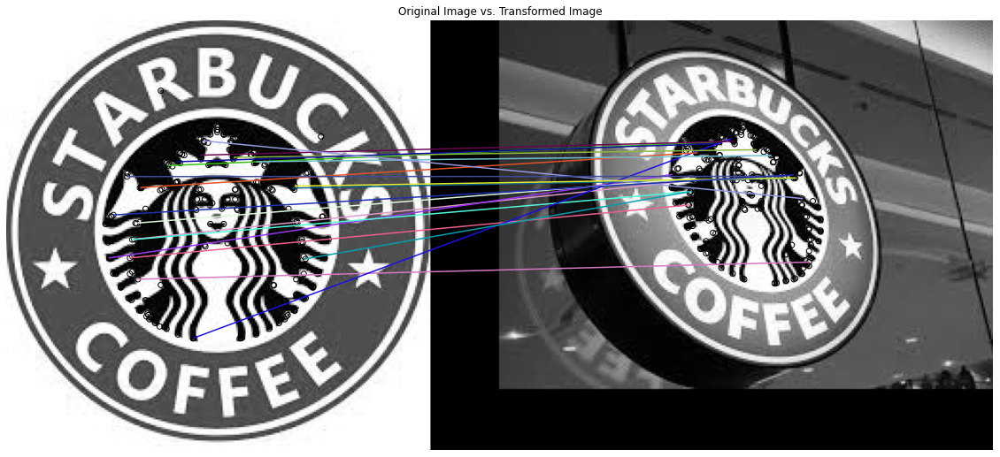

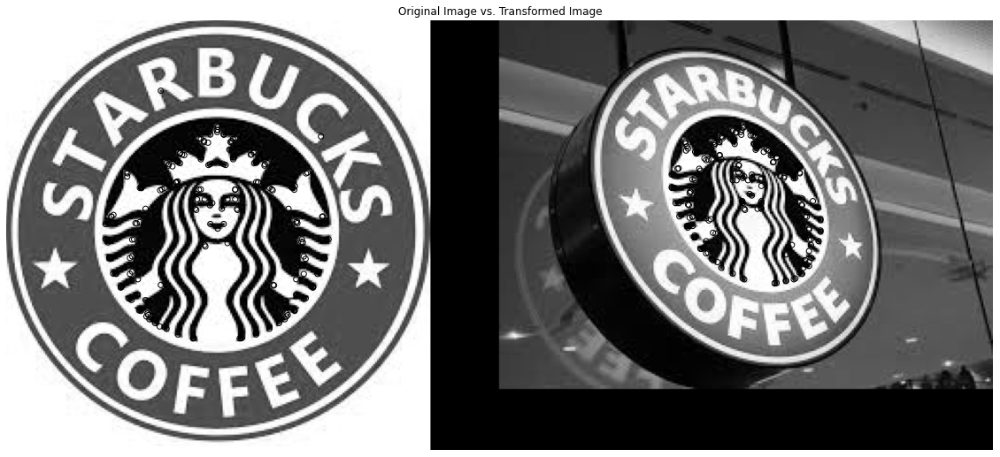

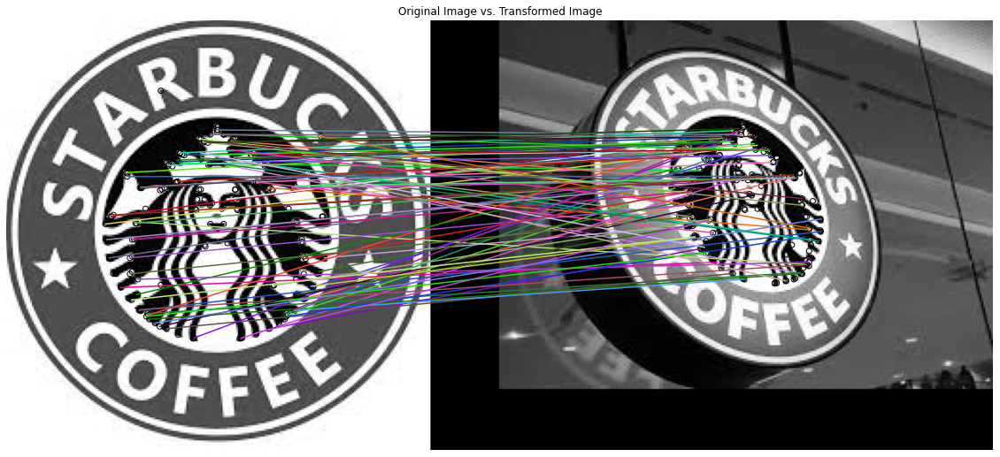

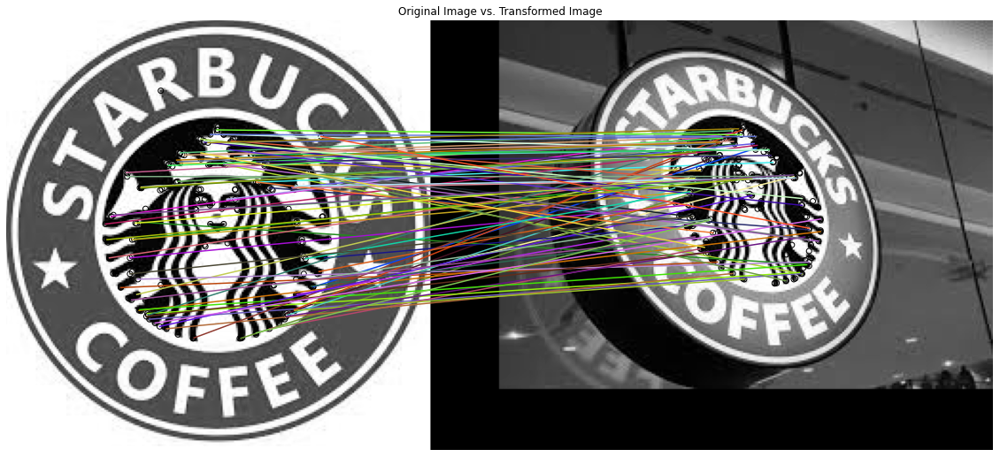

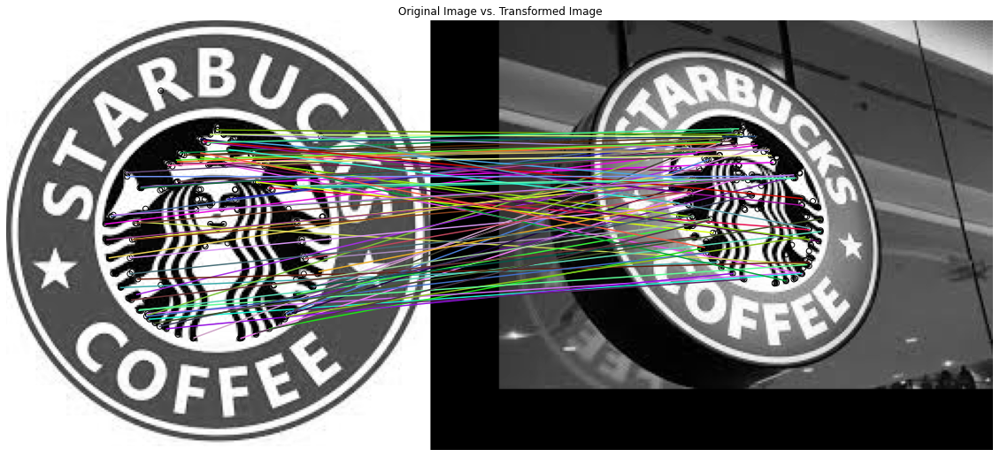

In [1158]:
# For different values of max_ratio
get_ORB(starbucks, starbucks4,ratio=0.9)
get_ORB(starbucks, starbucks4,ratio=0.6)
get_ORB(starbucks, starbucks4,ratio=1.5)
get_ORB(starbucks, starbucks4,ratio=3)
get_ORB(starbucks, starbucks4,ratio=10)

Repeate the experiment comparing the `starbucks.jpg` image as a model, and showing its matches to all Starbucks images, sorting them based on their similarity to the model. Comment when does the algorithm work better. 

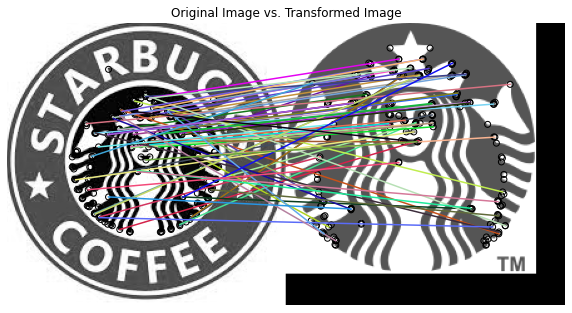

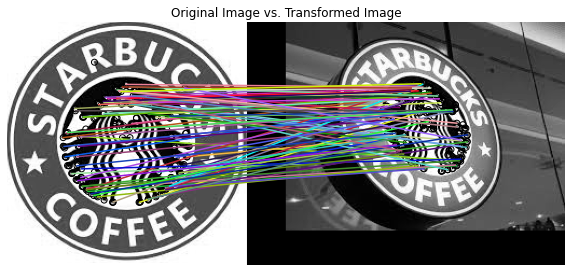

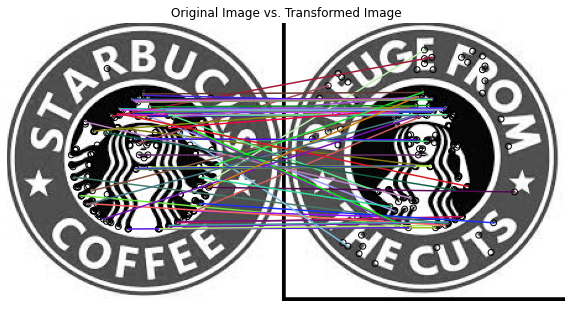

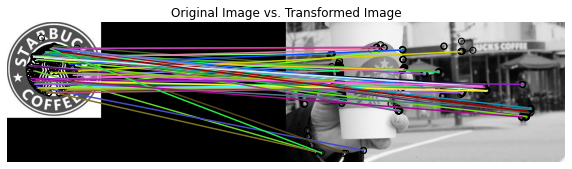

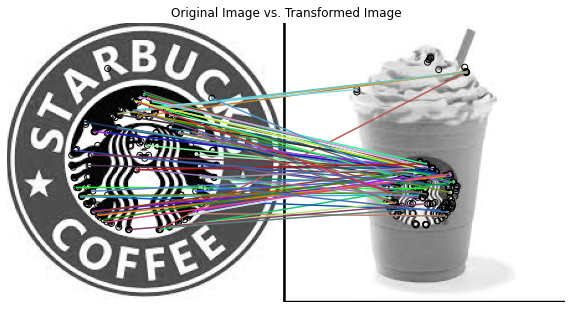

In [1203]:
# First we read all the images
starbucks = io.imread('images/starbucks.jpg')
starbucks2 = io.imread('images/starbucks2.png')
starbucks4 = io.imread('images/starbucks4.jpg')
starbucks5 = io.imread('images/starbucks5.png')
starbucks6 = io.imread('images/starbucks6.jpg')
starbucksCup = io.imread('images/starbucksCup.jpg')

# Using the function get_ORB to match the logo to all forms and shapes
get_ORB(starbucks, starbucks2, figsize=(10,10))
get_ORB(starbucks, starbucks4, figsize=(10,10))
get_ORB(starbucks, starbucks5, figsize=(10,10))
get_ORB(starbucks, starbucks6, figsize=(10,10))
get_ORB(starbucks, starbucksCup, figsize=(10,10))

In [1283]:
collect = [starbucks, starbucks2, starbucks4, starbucks5, starbucks6, starbucksCup]

In [1284]:
from queue import PriorityQueue
def compare_ORB(model, collect, n_keyP=400, ratio = 1.0):
    """
    function that returns a result image by matching the keypoints of two images
        img1: one of the image we want to match with the other
        img2: the other image to be matched
        n_keyP: parameter of the ORB function
        ratio: parameter max_ratio for match_descritors() function
    """
    if model.shape[2] == 3:
        model = rgb2gray(model)
    elif model.shape[2] == 4:
        model = rgb2gray(rgba2rgb(model))
    
    # Usinf priority queue to order by similarity
    pq = PriorityQueue()
    
    # For each image in collect we need to compute the ORB
    for img in collect:
        # First we convert to grayscale if necesary:
        if img.shape[2] == 3:
            img = rgb2gray(img)
        elif img.shape[2] == 4:
            img = rgb2gray(rgba2rgb(img))
        
        # Oriented FAST and rotated BRIEF feature detector and binary descriptor extractor
        descriptor_extractor = ORB(n_keypoints=n_keyP)

        # Detect oriented FAST keypoints and extract BRIEF descriptors.
        descriptor_extractor.detect_and_extract(model)
        # Getting the keypoints and descriptors of the first image 
        keypoints1 = descriptor_extractor.keypoints
        descriptors1 = descriptor_extractor.descriptors

        # Detect oriented FAST keypoints and extract BRIEF descriptors of the second image
        descriptor_extractor.detect_and_extract(img)
        # Getting the keypoints and descriptors of the second image
        keypoints2 = descriptor_extractor.keypoints
        descriptors2 = descriptor_extractor.descriptors

        # For each descriptor in the first set this matcher finds the closest descriptor 
        # in the second set (and vice-versa in the case of enabled cross-checking).
        matches = match_descriptors(descriptors1, descriptors2, cross_check=True, max_ratio=ratio)
    
        # We need to order by max to min, so invert the value to negative
        pq.put((-len(matches), [model, img, keypoints1, keypoints2, matches]))
    
    size = pq.qsize()
    # Need to print all images in orden in the pq
    for i in range (size):
        # Get the most similar one
        image = pq.get()
        # Print the similarity
        print("Similarity: ", abs(image[0])*(100/n_keyP), "%")
        
        # print the image
        fig, ax = plt.subplots(nrows=1, ncols=1, figsize = (10,10))
        plot_matches(ax, image[1][0], image[1][1], image[1][2], image[1][3], image[1][4])
        ax.axis('off')
        ax.set_title("Original Image vs. Transformed Image")
        plt.show()

Similarity:  100.0 %


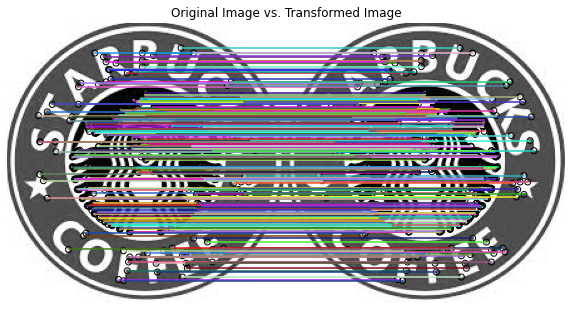

Similarity:  40.25 %


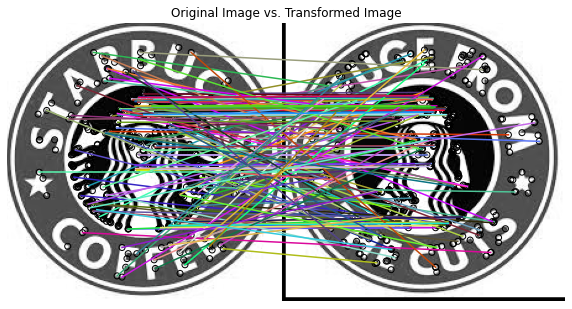

Similarity:  39.25 %


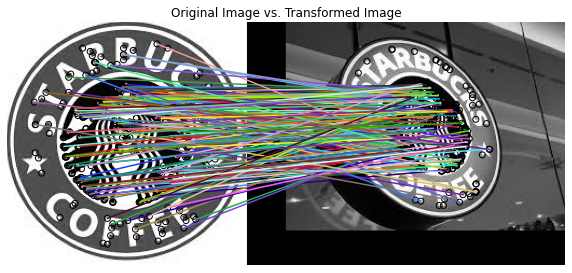

Similarity:  38.25 %


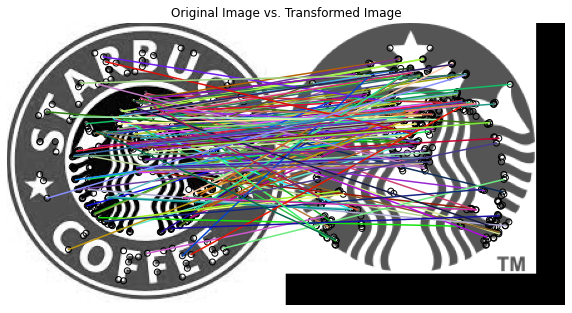

Similarity:  34.25 %


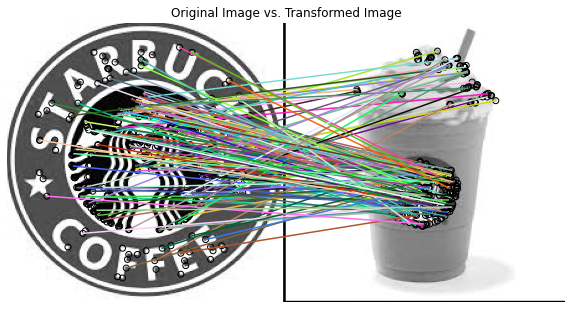

Similarity:  31.25 %


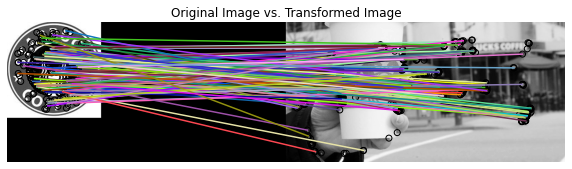

In [1285]:
# Plot the images with ORB comparing the similarity
compare_ORB(starbucks, collect)

**3.3** Repeate the experiment: 
- Changing the orientation of the model image by rotating it and comparing it with its original version. Help: you can use the rotate() function from skimage.transform 
- Change the scale and orientation of the scene image and compare it with the model image.

**Help:** To do so, you can use the function given below as example:

```
import transform as tf
rotationdegrees = 180
img_rotated = tf.rotate(image2transform, rotationdegrees)
```

or

```
tform = tf.AffineTransform(scale=(1.2, 1.2), translation=(0, -100))
img_transformed = tf.warp(image2transform, tform)
```

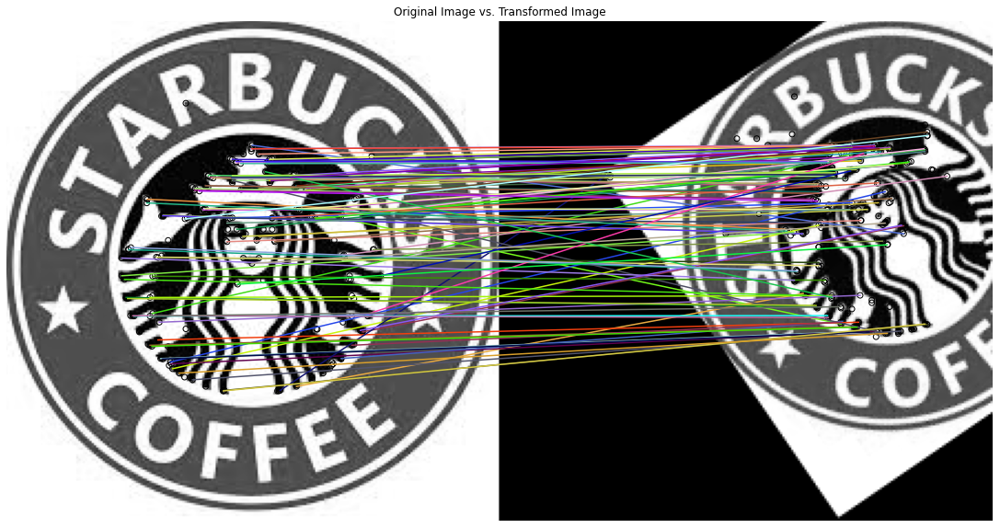

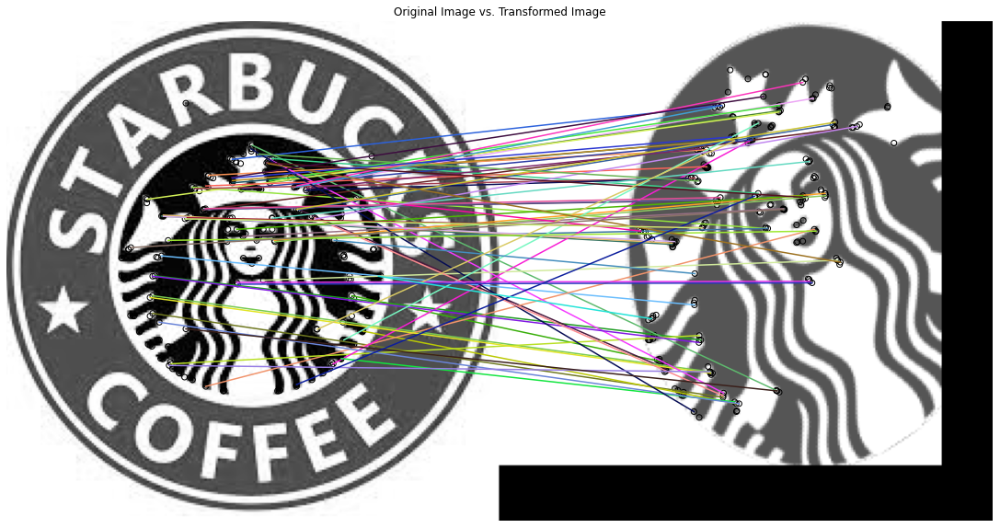

In [1185]:
from skimage import transform as tf
# We read the needed images
starbucks = io.imread('images/starbucks.jpg')
starbucks2 = io.imread('images/starbucks2.png')

# Rotate and translate the original one
tform = tf.AffineTransform(scale=(1.2, 1.2), rotation=0.6, translation=(0, -100))
starbucks_rotated = tf.warp(starbucks, tform)

# Rotate and translate one example of the set
tform = tf.AffineTransform(scale=(1.2, 1.0), rotation=0.5, translation=(0, -70))
starbucks_rotated2 = tf.warp(starbucks2, tform)

# Apply the ORB
get_ORB(starbucks, starbucks_rotated)
get_ORB(starbucks, starbucks_rotated2)

**(Optional)** Repeat the experiment (3.1 to 3.3) with a new group of images. You could use Coca-Cola advertisements or from another famous brand, easily to find on internet.


In [1236]:
# First we read all the images
ic2 = io.ImageCollection('images/CocaColaImages/*')

In [1231]:
colaLogo = ic2[-1]
colaLogo_gay = rgb2gray(rgba2rgb(colaLogo))

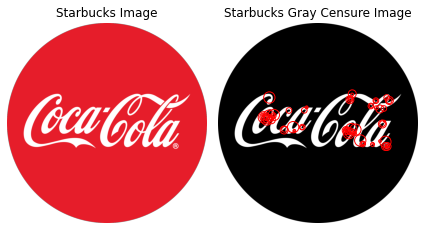

In [1220]:
# 3.1: Find the censure of the grayscale image and plot it
detector = CENSURE(min_scale=1, max_scale=8, mode='DoB', non_max_threshold=0.1, line_threshold=10)

fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(6, 6))

ax[0].imshow(colaLogo)
ax[0].set_title("Starbucks Image")

detector.detect(colaLogo_gay)

ax[1].imshow(colaLogo_gay, cmap=plt.cm.gray)
ax[1].scatter(detector.keypoints[:, 1], detector.keypoints[:, 0], 2**detector.scales, facecolors='none', edgecolors='r')
ax[1].set_title('Starbucks Gray Censure Image')

for a in ax:
    a.axis('off')

plt.tight_layout()
plt.show()

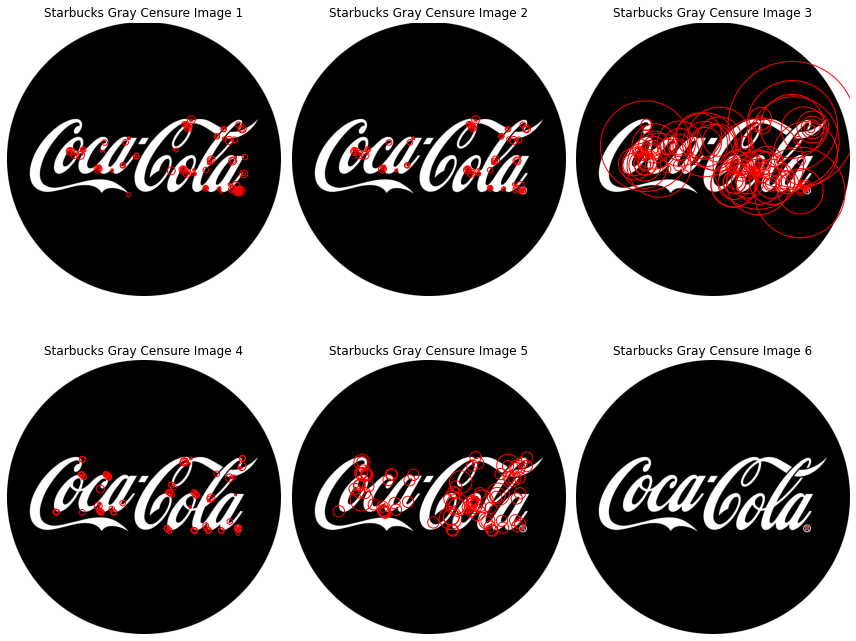

In [1186]:
# We can see some examples applying different parameters values
fig, ax = plt.subplots(nrows=2, ncols=3, figsize=(12, 10))

detector = CENSURE(min_scale=1, max_scale=7, mode='DoB', non_max_threshold=0.01, line_threshold=100)
detector.detect(colaLogo_gay)

ax[0][0].imshow(colaLogo_gay, cmap=plt.cm.gray)
ax[0][0].scatter(detector.keypoints[:, 1], detector.keypoints[:, 0], 2**detector.scales, facecolors='none', edgecolors='r')
ax[0][0].set_title('Starbucks Gray Censure Image 1')

detector = CENSURE(min_scale=1, max_scale=7, mode='DoB', non_max_threshold=0.2, line_threshold=50)
detector.detect(colaLogo_gay)

ax[0][1].imshow(colaLogo_gay, cmap=plt.cm.gray)
ax[0][1].scatter(detector.keypoints[:, 1], detector.keypoints[:, 0], 2**detector.scales, facecolors='none', edgecolors='r')
ax[0][1].set_title('Starbucks Gray Censure Image 2')

detector = CENSURE(min_scale=5, max_scale=15, mode='DoB', non_max_threshold=0.2, line_threshold=50)
detector.detect(colaLogo_gay)

ax[0][2].imshow(colaLogo_gay, cmap=plt.cm.gray)
ax[0][2].scatter(detector.keypoints[:, 1], detector.keypoints[:, 0], 2**detector.scales, facecolors='none', edgecolors='r')
ax[0][2].set_title('Starbucks Gray Censure Image 3')

detector = CENSURE(min_scale=1, max_scale=7, mode='Octagon', non_max_threshold=0.1, line_threshold=100)
detector.detect(colaLogo_gay)

ax[1][0].imshow(colaLogo_gay, cmap=plt.cm.gray)
ax[1][0].scatter(detector.keypoints[:, 1], detector.keypoints[:, 0], 2**detector.scales, facecolors='none', edgecolors='r')
ax[1][0].set_title('Starbucks Gray Censure Image 4')

detector = CENSURE(min_scale=6, max_scale=10, mode='Octagon', non_max_threshold=0.1, line_threshold=50)
detector.detect(colaLogo_gay)

ax[1][1].imshow(colaLogo_gay, cmap=plt.cm.gray)
ax[1][1].scatter(detector.keypoints[:, 1], detector.keypoints[:, 0], 2**detector.scales, facecolors='none', edgecolors='r')
ax[1][1].set_title('Starbucks Gray Censure Image 5')

detector = CENSURE(min_scale=1, max_scale=10, mode='DoB', non_max_threshold=0.5, line_threshold=200)
detector.detect(colaLogo_gay)

ax[1][2].imshow(colaLogo_gay, cmap=plt.cm.gray)
ax[1][2].scatter(detector.keypoints[:, 1], detector.keypoints[:, 0], 2**detector.scales, facecolors='none', edgecolors='r')
ax[1][2].set_title('Starbucks Gray Censure Image 6')


for a in ax[0]:
    a.axis('off')
    
for a in ax[1]:
    a.axis('off')

plt.tight_layout()
plt.show()

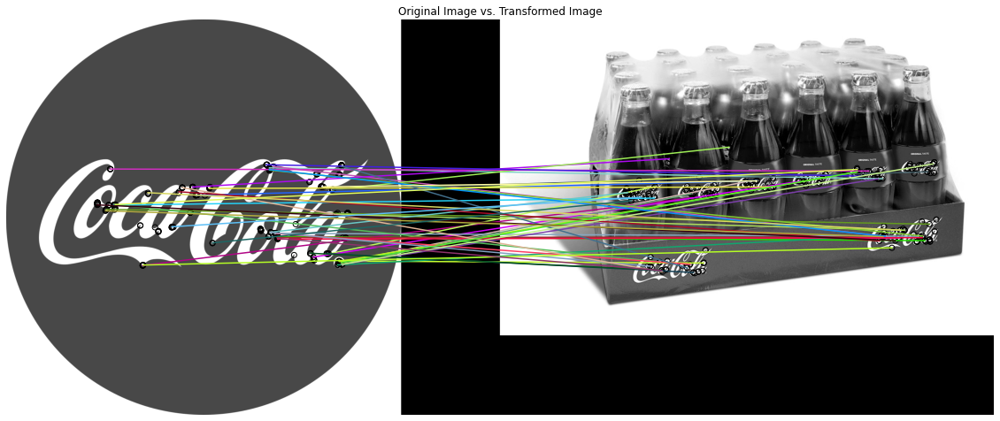

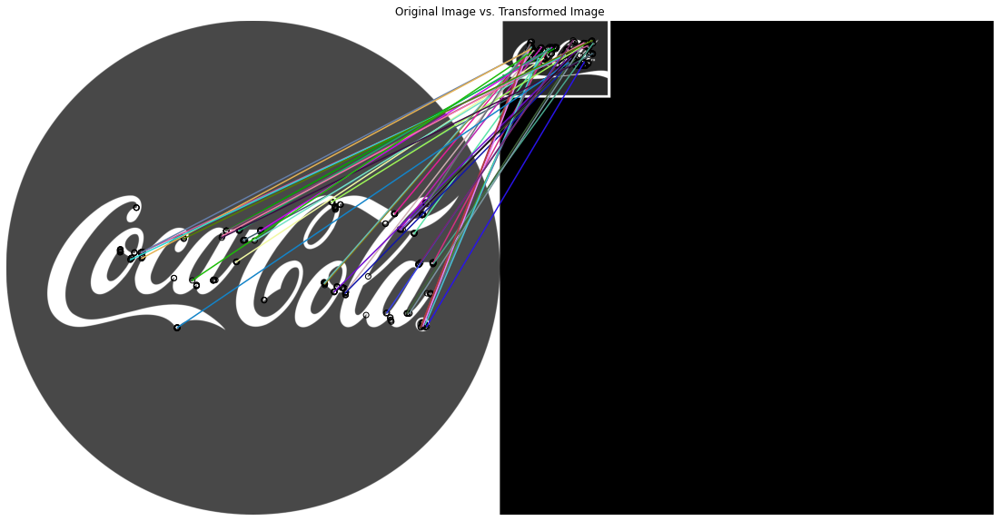

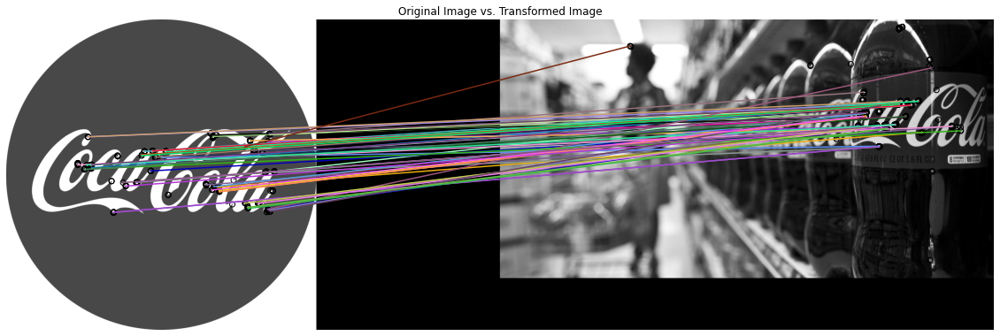

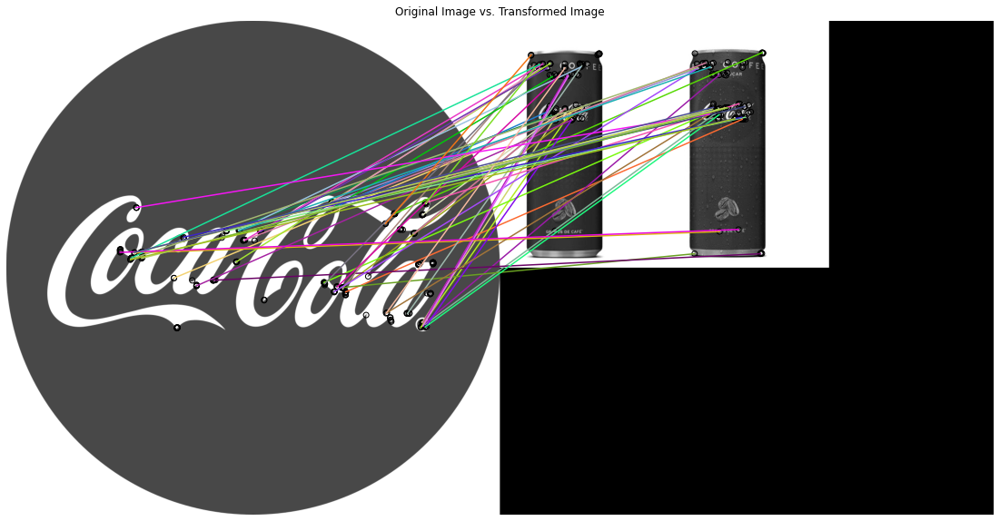

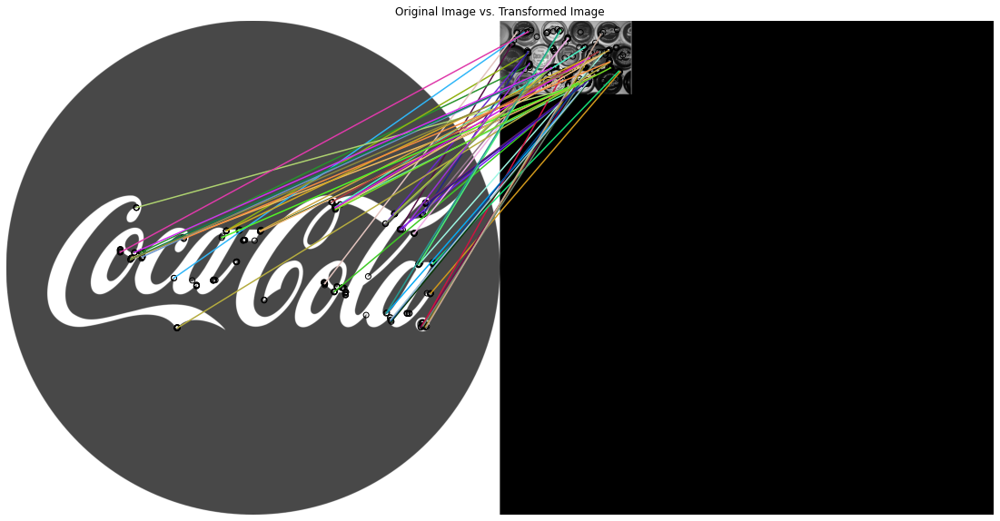

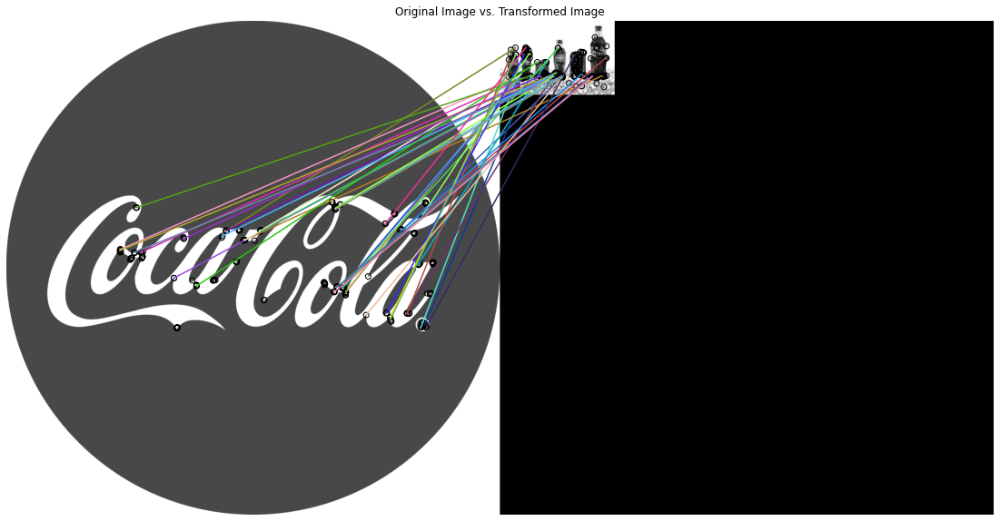

In [1187]:
# 3.2: Apply ORB to the set of images
for i in range (len(ic2)-1):
    get_ORB(colaLogo, ic2[i])

In [1277]:
# Get the 
collect = [colaLogo]
for i in range(len(ic2)-1):
    collect.append(ic2[i])

Similarity:  31.0 %


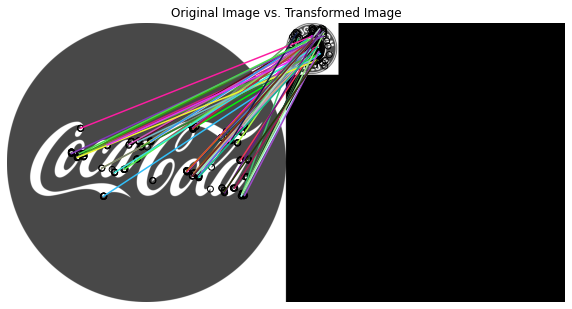

Similarity:  29.5 %


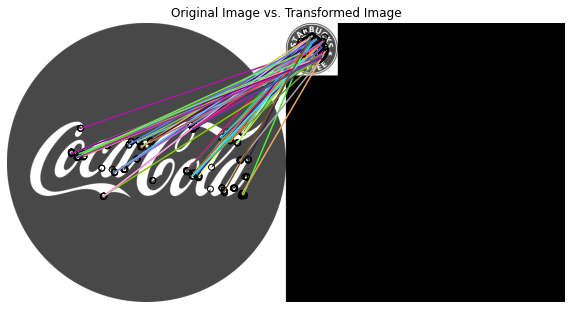

Similarity:  26.0 %


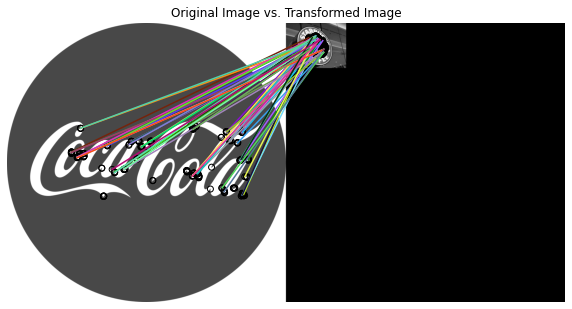

Similarity:  23.0 %


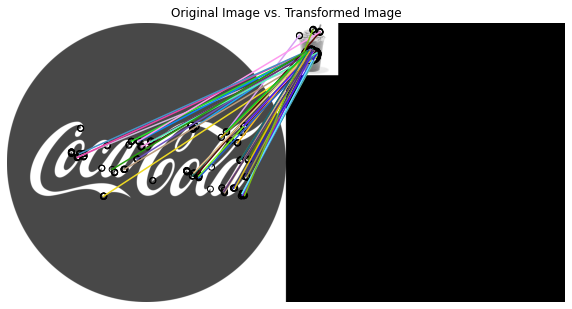

Similarity:  22.0 %


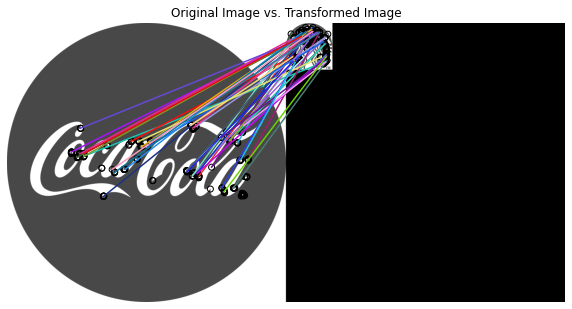

Similarity:  18.5 %


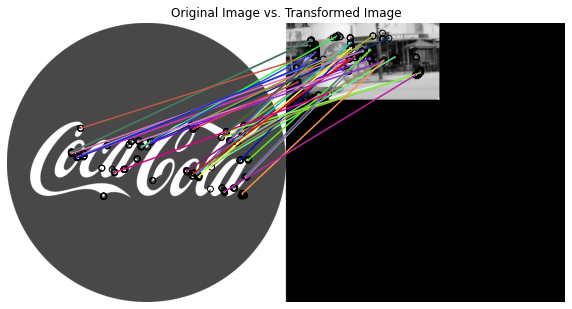

In [1286]:
# Compare the similarity
compare_ORB(colaLogo, collect, n_keyP=200)

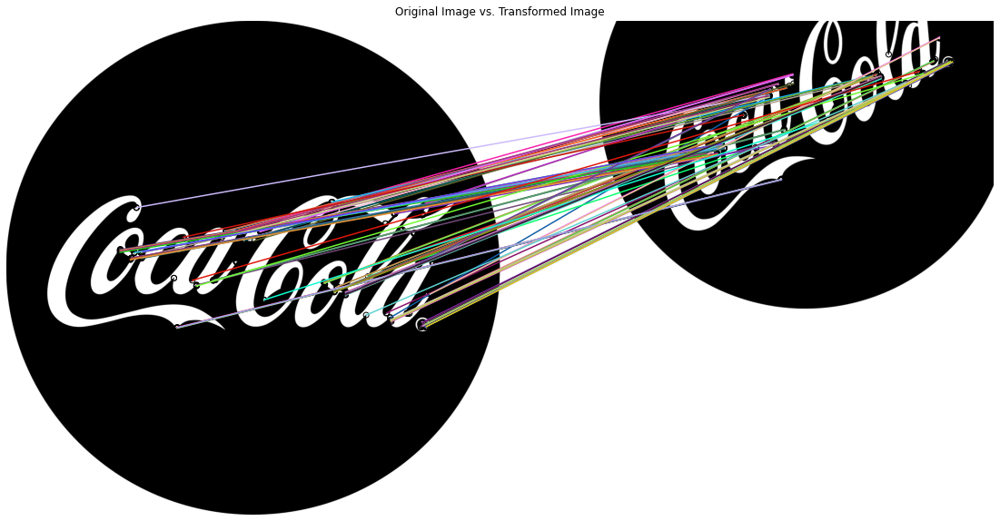

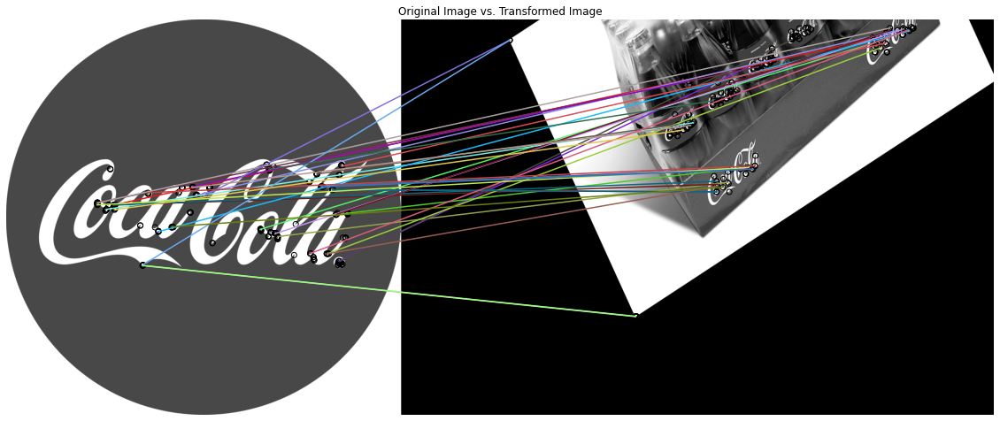

In [1189]:
# 3.3: ORB with rotate and translate
cocacola = ic2[-1]
cocacola2 = ic2[0]

# Rotate and translate the original one
tform = tf.AffineTransform(scale=(1.2, 1.2), rotation=0.6, translation=(0, -100))
cola_rotated = tf.warp(cocacola, tform)

# Rotate and translate one example of the set
tform = tf.AffineTransform(scale=(1.2, 1.0), rotation=0.5, translation=(0, -70))
cola_rotated2 = tf.warp(cocacola2, tform)

# Apply the ORB
get_ORB(cocacola, cola_rotated)
get_ORB(cocacola, cola_rotated2)

**3.4** Analysis of the applied techniques and results

- What are the advantages of the ORB object detection with respect to the HOG and template object detector?

- What would happen if you analyse an image that does not contain the Starbucks logo? 

- Could you think of ways of defining a quality measure for the correspondance between two images? (no need of implementing it) 

What are the advantages of the ORB object detection with respect to the HOG and template object detector?
> Using the ORB descriptor we can better extract the feature independing the scale by help of SIFT scale invariance, and it 'depends' of less properties of the image comparing to the HOG descriptor. And it is important to know that is better matching for local features, so it allows more 'forms and shapes' of a template or target image. Like with different color or perspective of the logo starbuck we can still find it.

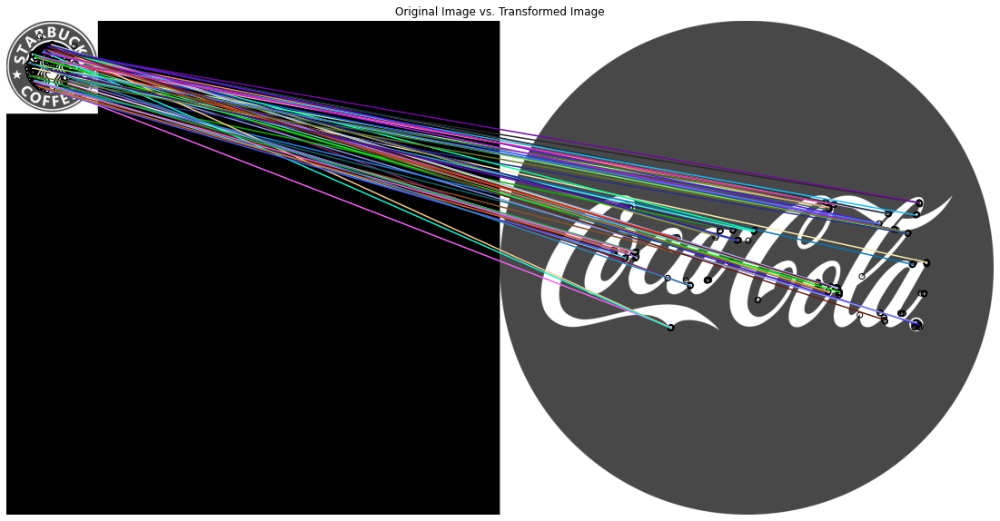

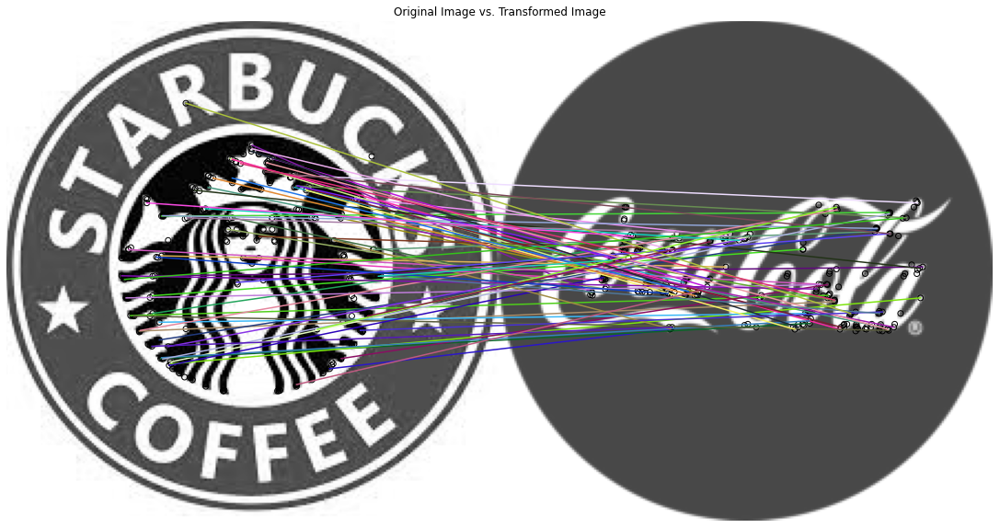

In [1195]:
# Matching not containing logo 
from skimage.transform import resize
get_ORB(starbucks, colaLogo)
colaLogo = resize(colaLogo, (226,223))
get_ORB(starbucks, colaLogo)

What would happen if you analyse an image that does not contain the Starbucks logo? 
> The descriptor even will match some points, because they are similars. But when we try to make aligment or mosaic construction, it will not work.

Could you think of ways of defining a quality measure for the correspondance between two images? (no need of implementing it)
> It can be a possible solution using the similarity comparing like in exercise 3.2, a high similarity means a higher match between two images. Of course then basing in a ratio or distance between two local points feaute. And also we can think about the closest point matches of the first image if matches with the closest point of the second image.

### Appendix

In [27]:
# In case the plot_matches() function gives you some problems, you can use the following one:

from skimage.util import img_as_float
import numpy as np

def plot_matches_aux(ax, image1, image2, keypoints1, keypoints2, matches,
                 keypoints_color='k', matches_color=None, only_matches=False):
    """Plot matched features.
    Parameters
    ----------
    ax : matplotlib.axes.Axes
        Matches and image are drawn in this ax.
    image1 : (N, M [, 3]) array
        First grayscale or color image.
    image2 : (N, M [, 3]) array
        Second grayscale or color image.
    keypoints1 : (K1, 2) array
        First keypoint coordinates as ``(row, col)``.
    keypoints2 : (K2, 2) array
        Second keypoint coordinates as ``(row, col)``.
    matches : (Q, 2) array
        Indices of corresponding matches in first and second set of
        descriptors, where ``matches[:, 0]`` denote the indices in the first
        and ``matches[:, 1]`` the indices in the second set of descriptors.
    keypoints_color : matplotlib color, optional
        Color for keypoint locations.
    matches_color : matplotlib color, optional
        Color for lines which connect keypoint matches. By default the
        color is chosen randomly.
    only_matches : bool, optional
        Whether to only plot matches and not plot the keypoint locations.
    """

    image1 = img_as_float(image1)
    image2 = img_as_float(image2)

    new_shape1 = list(image1.shape)
    new_shape2 = list(image2.shape)

    if image1.shape[0] < image2.shape[0]:
        new_shape1[0] = image2.shape[0]
    elif image1.shape[0] > image2.shape[0]:
        new_shape2[0] = image1.shape[0]

    if image1.shape[1] < image2.shape[1]:
        new_shape1[1] = image2.shape[1]
    elif image1.shape[1] > image2.shape[1]:
        new_shape2[1] = image1.shape[1]

    if new_shape1 != image1.shape:
        new_image1 = np.zeros(new_shape1, dtype=image1.dtype)
        new_image1[:image1.shape[0], :image1.shape[1]] = image1
        image1 = new_image1

    if new_shape2 != image2.shape:
        new_image2 = np.zeros(new_shape2, dtype=image2.dtype)
        new_image2[:image2.shape[0], :image2.shape[1]] = image2
        image2 = new_image2

    image = np.concatenate([image1, image2], axis=1)

    offset = image1.shape

    if not only_matches:
        ax.scatter(keypoints1[:, 1], keypoints1[:, 0],
                   facecolors='none', edgecolors=keypoints_color)
        ax.scatter(keypoints2[:, 1] + offset[1], keypoints2[:, 0],
                   facecolors='none', edgecolors=keypoints_color)

    ax.imshow(image, interpolation='nearest', cmap='gray')
    ax.axis((0, 2 * offset[1], offset[0], 0))

    for i in range(matches.shape[0]):
        idx1 = matches[i, 0]
        idx2 = matches[i, 1]

        if matches_color is None:
            color = np.random.rand(3)
        else:
            color = matches_color

        ax.plot((keypoints1[idx1, 1], keypoints2[idx2, 1] + offset[1]),
                (keypoints1[idx1, 0], keypoints2[idx2, 0]),
                '-', color=color)